# GA DSIF 11 Capstone Project:

# Dance Move Classifier (Originality Never Dies) (Part 2)


## Lua Yeow Wen
---

## Exploratory Data Analysis

### Install non built-in Python library

In [1]:
#!pip install imageio

### Import Libraries

In [2]:
# Standard Library Imports
import os
import time

# Data Handling and Visualization
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import imageio

# Computer Vision Libraries
import cv2
import mediapipe as mp
from mpl_toolkits.mplot3d import Axes3D

# IPython Display Tools
from IPython.display import Image, display


# Set the option to display all rows and columns
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

### Define File Paths
---

* moves_df_path : Folder location for moves_df csv file

In [3]:
# Define file paths
current_directory = os.getcwd() # get current directory so that it is portable to other users
moves_df_path = current_directory

### Load moves_df

In [4]:
moves_df = pd.read_csv("moves_df.csv")

In [5]:
moves_df.head()

,videolandmarks_path,videolandmarks_name,video_path,video_name,dataset_csv_path,dataset_csv,move_name,video_num,bboy_name,frame_num_start,frame_num_end
0,video_landmarks\cc\cc_0_landmark.mp4,cc_0_landmark.mp4,archive_video\cc\cc_0.mp4,cc_0,dataset_csv\cc\cc_0.csv,cc_0.csv,cc,0,bboy2,0,59
1,video_landmarks\cc\cc_1_landmark.mp4,cc_1_landmark.mp4,archive_video\cc\cc_1.mp4,cc_1,dataset_csv\cc\cc_1.csv,cc_1.csv,cc,1,bboy2,0,59
2,video_landmarks\cc\cc_2_landmark.mp4,cc_2_landmark.mp4,archive_video\cc\cc_2.mp4,cc_2,dataset_csv\cc\cc_2.csv,cc_2.csv,cc,2,bboy2,0,59
3,video_landmarks\cc\cc_3_landmark.mp4,cc_3_landmark.mp4,archive_video\cc\cc_3.mp4,cc_3,dataset_csv\cc\cc_3.csv,cc_3.csv,cc,3,bboy2,0,59
4,video_landmarks\cc\cc_4_landmark.mp4,cc_4_landmark.mp4,archive_video\cc\cc_4.mp4,cc_4,dataset_csv\cc\cc_4.csv,cc_4.csv,cc,4,bboy2,0,59


### Create Dataframe landmark_df
---

landmark_df contains 

* videolandmarks_path : Full location of the video attempts with landmarks for the specific move
* videolandmarks_name : File name of the video with landmark
* video_name : File name of the video attempts that will be processed
* bboy_name : Name of the bboy
* move_name : Name of the move
* frame : Frame number
* video_num : Video attempt number
* x,y,z coordinates and visibility information of landmarks [0, 9, 10, 12, 14, 16, 11, 13, 15, 24, 26, 28, 23, 25, 27]

In [6]:
# Prepare columns for landmark_df
columns = ['videolandmarks_path', 'videolandmarks_name', 'video_name', 'bboy_name', 'move_name', 'frame', 'video_num'] + \
          [f'p{i}{c}' for i in [0, 9, 10, 12, 14, 16, 11, 13, 15, 24, 26, 28, 23, 25, 27] for c in ['x', 'y', 'z', 'v']]

# Create DataFrame landmark_df
landmark_df = pd.DataFrame(columns=columns)

for index, row in moves_df.iterrows():
    # Construct the full path to the CSV file containing landmark data for each video
    full_csv_path = os.path.join(current_directory, row['dataset_csv_path'])

    # Load the landmark data from the CSV file
    landmarks_data = pd.read_csv(full_csv_path)
    
    # Filter and select only the data for frames within the specified range in moves_df
    frames_data = landmarks_data[(landmarks_data['frame'] >= row['frame_num_start']) & 
                                 (landmarks_data['frame'] <= row['frame_num_end'])]

    # Select only the required columns
    selected_columns = ['frame'] + [f'p{i}{c}' for i in [0, 9, 10, 12, 14, 16, 11, 13, 15, 24, 26, 28, 23, 25, 27] for c in ['x', 'y', 'z', 'v']]
    frames_data = frames_data[selected_columns]
    
    # Add bboy_name, move_name, video_num, videolandmarks_path, videolandmarks_name, and video_name columns
    frames_data['bboy_name'] = row['bboy_name']
    frames_data['move_name'] = row['move_name']
    frames_data['video_num'] = row['video_num']
    frames_data['videolandmarks_path'] = row['videolandmarks_path']  # Using relative path directly
    frames_data['videolandmarks_name'] = row['videolandmarks_name']
    frames_data['video_name'] = row['video_name']
    
    # Combine the processed data with the main landmark DataFrame
    landmark_df = pd.concat([landmark_df, frames_data], ignore_index=True)

# Reset the index
landmark_df.reset_index(drop=True, inplace=True)

### Check First 5 Rows of landmark_df

In [7]:
landmark_df.head()

,videolandmarks_path,videolandmarks_name,video_name,bboy_name,move_name,frame,video_num,p0x,p0y,p0z,p0v,p9x,p9y,p9z,p9v,p10x,p10y,p10z,p10v,p12x,p12y,p12z,p12v,p14x,p14y,p14z,p14v,p16x,p16y,p16z,p16v,p11x,p11y,p11z,p11v,p13x,p13y,p13z,p13v,p15x,p15y,p15z,p15v,p24x,p24y,p24z,p24v,p26x,p26y,p26z,p26v,p28x,p28y,p28z,p28v,p23x,p23y,p23z,p23v,p25x,p25y,p25z,p25v,p27x,p27y,p27z,p27v
0,video_landmarks\cc\cc_0_landmark.mp4,cc_0_landmark.mp4,cc_0,bboy2,cc,0,0,0.543548,0.566468,-0.415753,0.999999,0.541779,0.575044,-0.356573,0.999999,0.526518,0.572570,-0.373351,1.000000,0.409218,0.580528,-0.222450,0.999989,0.309968,0.623587,-0.343290,0.991243,0.311930,0.621121,-0.574217,0.986506,0.579275,0.606702,-0.186289,0.999983,0.611341,0.681294,-0.212844,0.992321,0.647083,0.733555,-0.363043,0.984817,0.412909,0.690481,0.004337,0.999946,0.326924,0.684356,-0.439153,0.991017,0.388172,0.751647,-0.062811,0.989071,0.504181,0.700395,-0.004534,0.999777,0.521515,0.723606,-0.443717,0.996458,0.515571,0.746613,0.009681,0.954331
1,video_landmarks\cc\cc_0_landmark.mp4,cc_0_landmark.mp4,cc_0,bboy2,cc,1,0,0.574766,0.566106,-0.384113,0.999999,0.569903,0.574580,-0.326910,0.999999,0.555795,0.571253,-0.347266,0.999999,0.447039,0.574144,-0.200695,0.999982,0.348402,0.595093,-0.363989,0.991829,0.433878,0.570379,-0.521583,0.986783,0.585856,0.608431,-0.175980,0.999979,0.598324,0.682282,-0.197924,0.991245,0.617117,0.736417,-0.290717,0.983430,0.416322,0.688600,0.012657,0.999943,0.324291,0.684367,-0.358078,0.991038,0.387635,0.752221,-0.063954,0.988914,0.505040,0.699688,-0.012846,0.999782,0.515573,0.721153,-0.429674,0.995976,0.512791,0.746365,-0.028663,0.955213
2,video_landmarks\cc\cc_0_landmark.mp4,cc_0_landmark.mp4,cc_0,bboy2,cc,2,0,0.606557,0.566107,-0.355650,0.999998,0.598298,0.573998,-0.294486,0.999998,0.587752,0.570516,-0.321814,0.999999,0.465289,0.567869,-0.204892,0.999976,0.395970,0.582522,-0.418247,0.992307,0.508019,0.551749,-0.537300,0.987259,0.593552,0.610207,-0.124355,0.999972,0.589852,0.682268,-0.166527,0.988464,0.605964,0.740232,-0.277468,0.979356,0.416231,0.682326,0.012323,0.999946,0.317249,0.685586,-0.372363,0.991280,0.385947,0.752181,-0.064197,0.988656,0.504237,0.694639,-0.012563,0.999795,0.501070,0.712545,-0.418847,0.995636,0.508697,0.746283,-0.017308,0.957671
3,video_landmarks\cc\cc_0_landmark.mp4,cc_0_landmark.mp4,cc_0,bboy2,cc,3,0,0.630734,0.565902,-0.328350,0.999997,0.619575,0.572671,-0.263538,0.999998,0.608875,0.568185,-0.296159,0.999998,0.494051,0.557870,-0.206144,0.999970,0.466731,0.577073,-0.430725,0.991612,0.569735,0.554930,-0.566293,0.986372,0.607161,0.610860,-0.091694,0.999972,0.586740,0.681576,-0.138003,0.982969,0.601801,0.737811,-0.268983,0.973594,0.416277,0.672334,0.009399,0.999949,0.303494,0.688532,-0.394117,0.991853,0.384519,0.749146,0.014310,0.987795,0.503660,0.687842,-0.009607,0.999812,0.500072,0.709589,-0.386229,0.995692,0.499996,0.740150,0.053389,0.959888
4,video_landmarks\cc\cc_0_landmark.mp4,cc_0_landmark.mp4,cc_0,bboy2,cc,4,0,0.654555,0.563768,-0.280966,0.999997,0.641959,0.570531,-0.218685,0.999998,0.632236,0.566228,-0.248847,0.999997,0.527025,0.552574,-0.186584,0.999962,0.500939,0.577086,-0.423716,0.991185,0.620396,0.562540,-0.541837,0.985503,0.619000,0.610476,-0.054191,0.999973,0.586504,0.680193,-0.102298,0.978444,0.601960,0.740077,-0.209774,0.970003,0.416969,0.663602,0.009143,0.999954,0.286887,0.688254,-0.378740,0.992353,0.384470,0.745854,-0.003404,0.986373,0.501305,0.682691,-0.009347,0.999830,0.469508,0.703305,-0.415455,0.995909,0.492838,0.740909,-0.062058,0.962820


### Check Number of Rows and Columns for landmark_df

In [8]:
landmark_df.shape

(1440, 67)

**Rows:**
* Each row represents a frame of a 2 sec video (total 60 frames for a video)
* There are 8 videos attempts for each moves
* There are 3 moves in total
* Total rows: 8 x 3 x 60 = 1440

**Columns**
* The columns consist of 15 landmarks
* Each landmark consist of x,y,z coordinate and visibility
* There are also 7 no. of columns that consist information of the extracted video file
* Total columns: (15 x 4) + 7 = 67

### Rename Columns for landmark_df for Readability
---

Changing from landmark numbers to human features for readability

* p0 : nose
* p9 : mouth_left
* p10 : mouth_right
* p12 : right_shoulder
* p14 : right_elbow
* p16 : right_wrist
* p11 : left_shoulder
* p13 : left_elbow
* p15 : left_wrist
* p24 : right_hip
* p26 : right_knee
* p28 : right_ankle
* p23 : left_hip
* p25 : left_knee
* p27 : left_ankle

<img src="images/pose_landmarks_index.png" width="80%">

source: https://github.com/google/mediapipe/blob/master/docs/solutions/pose.md

In [9]:
column_mapping = {
    'p0x': 'nose_x', 'p0y': 'nose_y', 'p0z': 'nose_z', 'p0v': 'nose_v',
    'p9x': 'mouth_left_x', 'p9y': 'mouth_left_y', 'p9z': 'mouth_left_z', 'p9v': 'mouth_left_v',
    'p10x': 'mouth_right_x', 'p10y': 'mouth_right_y', 'p10z': 'mouth_right_z', 'p10v': 'mouth_right_v',
    'p12x': 'right_shoulder_x', 'p12y': 'right_shoulder_y', 'p12z': 'right_shoulder_z', 'p12v': 'right_shoulder_v',
    'p14x': 'right_elbow_x', 'p14y': 'right_elbow_y', 'p14z': 'right_elbow_z', 'p14v': 'right_elbow_v',
    'p16x': 'right_wrist_x', 'p16y': 'right_wrist_y', 'p16z': 'right_wrist_z', 'p16v': 'right_wrist_v',
    'p11x': 'left_shoulder_x', 'p11y': 'left_shoulder_y', 'p11z': 'left_shoulder_z', 'p11v': 'left_shoulder_v',
    'p13x': 'left_elbow_x', 'p13y': 'left_elbow_y', 'p13z': 'left_elbow_z', 'p13v': 'left_elbow_v',
    'p15x': 'left_wrist_x', 'p15y': 'left_wrist_y', 'p15z': 'left_wrist_z', 'p15v': 'left_wrist_v',
    'p24x': 'right_hip_x', 'p24y': 'right_hip_y', 'p24z': 'right_hip_z', 'p24v': 'right_hip_v',
    'p26x': 'right_knee_x', 'p26y': 'right_knee_y', 'p26z': 'right_knee_z', 'p26v': 'right_knee_v',
    'p28x': 'right_ankle_x', 'p28y': 'right_ankle_y', 'p28z': 'right_ankle_z', 'p28v': 'right_ankle_v',
    'p23x': 'left_hip_x', 'p23y': 'left_hip_y', 'p23z': 'left_hip_z', 'p23v': 'left_hip_v',
    'p25x': 'left_knee_x', 'p25y': 'left_knee_y', 'p25z': 'left_knee_z', 'p25v': 'left_knee_v',
    'p27x': 'left_ankle_x', 'p27y': 'left_ankle_y', 'p27z': 'left_ankle_z', 'p27v': 'left_ankle_v'
}

# Rename the columns in landmark_df
landmark_df.rename(columns=column_mapping, inplace=True)

### Check Data Types for landmark_df

In [10]:
landmark_df.dtypes

videolandmarks_path     object
videolandmarks_name     object
video_name              object
bboy_name               object
move_name               object
frame                   object
video_num               object
nose_x                 float64
nose_y                 float64
nose_z                 float64
nose_v                 float64
mouth_left_x           float64
mouth_left_y           float64
mouth_left_z           float64
mouth_left_v           float64
mouth_right_x          float64
mouth_right_y          float64
mouth_right_z          float64
mouth_right_v          float64
right_shoulder_x       float64
right_shoulder_y       float64
right_shoulder_z       float64
right_shoulder_v       float64
right_elbow_x          float64
right_elbow_y          float64
right_elbow_z          float64
right_elbow_v          float64
right_wrist_x          float64
right_wrist_y          float64
right_wrist_z          float64
right_wrist_v          float64
left_shoulder_x        float64
left_sho

### Check First 5 Rows of landmark_df (After Renaming Columns)

In [11]:
landmark_df.head()

,videolandmarks_path,videolandmarks_name,video_name,bboy_name,move_name,frame,video_num,nose_x,nose_y,nose_z,nose_v,mouth_left_x,mouth_left_y,mouth_left_z,mouth_left_v,mouth_right_x,mouth_right_y,mouth_right_z,mouth_right_v,right_shoulder_x,right_shoulder_y,right_shoulder_z,right_shoulder_v,right_elbow_x,right_elbow_y,right_elbow_z,right_elbow_v,right_wrist_x,right_wrist_y,right_wrist_z,right_wrist_v,left_shoulder_x,left_shoulder_y,left_shoulder_z,left_shoulder_v,left_elbow_x,left_elbow_y,left_elbow_z,left_elbow_v,left_wrist_x,left_wrist_y,left_wrist_z,left_wrist_v,right_hip_x,right_hip_y,right_hip_z,right_hip_v,right_knee_x,right_knee_y,right_knee_z,right_knee_v,right_ankle_x,right_ankle_y,right_ankle_z,right_ankle_v,left_hip_x,left_hip_y,left_hip_z,left_hip_v,left_knee_x,left_knee_y,left_knee_z,left_knee_v,left_ankle_x,left_ankle_y,left_ankle_z,left_ankle_v
0,video_landmarks\cc\cc_0_landmark.mp4,cc_0_landmark.mp4,cc_0,bboy2,cc,0,0,0.543548,0.566468,-0.415753,0.999999,0.541779,0.575044,-0.356573,0.999999,0.526518,0.572570,-0.373351,1.000000,0.409218,0.580528,-0.222450,0.999989,0.309968,0.623587,-0.343290,0.991243,0.311930,0.621121,-0.574217,0.986506,0.579275,0.606702,-0.186289,0.999983,0.611341,0.681294,-0.212844,0.992321,0.647083,0.733555,-0.363043,0.984817,0.412909,0.690481,0.004337,0.999946,0.326924,0.684356,-0.439153,0.991017,0.388172,0.751647,-0.062811,0.989071,0.504181,0.700395,-0.004534,0.999777,0.521515,0.723606,-0.443717,0.996458,0.515571,0.746613,0.009681,0.954331
1,video_landmarks\cc\cc_0_landmark.mp4,cc_0_landmark.mp4,cc_0,bboy2,cc,1,0,0.574766,0.566106,-0.384113,0.999999,0.569903,0.574580,-0.326910,0.999999,0.555795,0.571253,-0.347266,0.999999,0.447039,0.574144,-0.200695,0.999982,0.348402,0.595093,-0.363989,0.991829,0.433878,0.570379,-0.521583,0.986783,0.585856,0.608431,-0.175980,0.999979,0.598324,0.682282,-0.197924,0.991245,0.617117,0.736417,-0.290717,0.983430,0.416322,0.688600,0.012657,0.999943,0.324291,0.684367,-0.358078,0.991038,0.387635,0.752221,-0.063954,0.988914,0.505040,0.699688,-0.012846,0.999782,0.515573,0.721153,-0.429674,0.995976,0.512791,0.746365,-0.028663,0.955213
2,video_landmarks\cc\cc_0_landmark.mp4,cc_0_landmark.mp4,cc_0,bboy2,cc,2,0,0.606557,0.566107,-0.355650,0.999998,0.598298,0.573998,-0.294486,0.999998,0.587752,0.570516,-0.321814,0.999999,0.465289,0.567869,-0.204892,0.999976,0.395970,0.582522,-0.418247,0.992307,0.508019,0.551749,-0.537300,0.987259,0.593552,0.610207,-0.124355,0.999972,0.589852,0.682268,-0.166527,0.988464,0.605964,0.740232,-0.277468,0.979356,0.416231,0.682326,0.012323,0.999946,0.317249,0.685586,-0.372363,0.991280,0.385947,0.752181,-0.064197,0.988656,0.504237,0.694639,-0.012563,0.999795,0.501070,0.712545,-0.418847,0.995636,0.508697,0.746283,-0.017308,0.957671
3,video_landmarks\cc\cc_0_landmark.mp4,cc_0_landmark.mp4,cc_0,bboy2,cc,3,0,0.630734,0.565902,-0.328350,0.999997,0.619575,0.572671,-0.263538,0.999998,0.608875,0.568185,-0.296159,0.999998,0.494051,0.557870,-0.206144,0.999970,0.466731,0.577073,-0.430725,0.991612,0.569735,0.554930,-0.566293,0.986372,0.607161,0.610860,-0.091694,0.999972,0.586740,0.681576,-0.138003,0.982969,0.601801,0.737811,-0.268983,0.973594,0.416277,0.672334,0.009399,0.999949,0.303494,0.688532,-0.394117,0.991853,0.384519,0.749146,0.014310,0.987795,0.503660,0.687842,-0.009607,0.999812,0.500072,0.709589,-0.386229,0.995692,0.499996,0.740150,0.053389,0.959888
4,video_landmarks\cc\cc_0_landmark.mp4,cc_0_landmark.mp4,cc_0,bboy2,cc,4,0,0.654555,0.563768,-0.280966,0.999997,0.641959,0.570531,-0.218685,0.999998,0.632236,0.566228,-0.248847,0.999997,0.527025,0.552574,-0.186584,0.999962,0.500939,0.577086,-0.423716,0.991185,0.620396,0.562540,-0.541837,0.985503,0.619000,0.610476,-0.054191,0.999973,0.586504,0.680193,-0.102298,0.978444,0.601960,0.740077,-0.209774,0.970003,0.416969,0.663602,0.009143,0.999954,0.286887,0.688254,-0.378740,0.992353,0.384470,0.745854,-0.003404,0.986373,0.501305,0.682691,-0.009347,0.999830,0.469508,0.703305,-0.415455,0.995909,0.492838,0.740909,-0.06

### Display Moves that will be Analyzed
---

Show each bboy move as a GIF file for visual representations.

### Create User Defined Function: show_videolandmarks_name
---

* Display the moves in GIF format for visual representations.




**show_videolandmarks_name**

Parameters:

* df
* bboy_name
* move_name
* video_num


Function:

1. Filter the DataFrame corresponding to the provided parameters.
2. Retreive the video file with the file name from the filtered.
3. Read the video file and write into GIF file.
4. Display the GIF file.

In [12]:
def show_videolandmarks_name(df, bboy_name, move_name, video_num):
    # Filter the dataframe
    filtered_df = df[(df['bboy_name'] == bboy_name) &
                     (df['move_name'] == move_name) &
                     (df['video_num'] == video_num)]

    # Check if any entry matches the criteria
    if filtered_df.empty:
        print("No matching entry found.")
        return

    # Get the full video file path
    video_file = os.path.join(current_directory, filtered_df.iloc[0]['videolandmarks_path'])

    # Read video and process frames
    cap = cv2.VideoCapture(video_file)
    frames = []
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break
        # Convert to RGB and resize
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        height, width = frame_rgb.shape[:2]
        resized_frame = cv2.resize(frame_rgb, (width // 3, height // 3))  # Sizing the GIF
        frames.append(resized_frame)
    cap.release()

    # Write GIF
    gif_filename = 'output.gif'
    imageio.mimsave(gif_filename, frames, fps=10)  # Adjust fps as needed

    # Display the GIF
    return Image(filename=gif_filename)

### First Move: "cc"

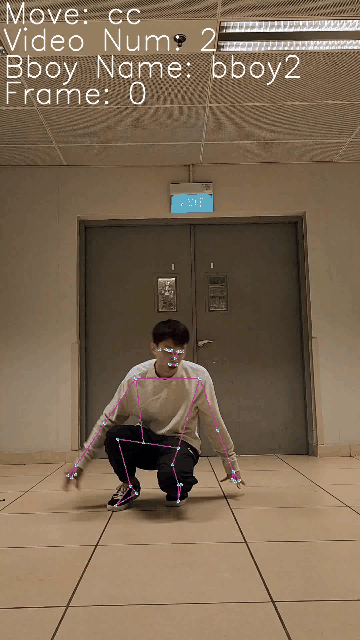

In [13]:
# CC
show_videolandmarks_name(landmark_df, 'bboy2', 'cc', 2)

**Insights:**

* The move is performed by kicking the left leg forward, diagonally whilst twisting the body so that the right upper limb can swing and palm can touch the ground for support.
* The motion is done only once.
* The start pose and mid pose of the move is different.
* End pose is the same as the start pose.

### Second Move: "Jackhammer"

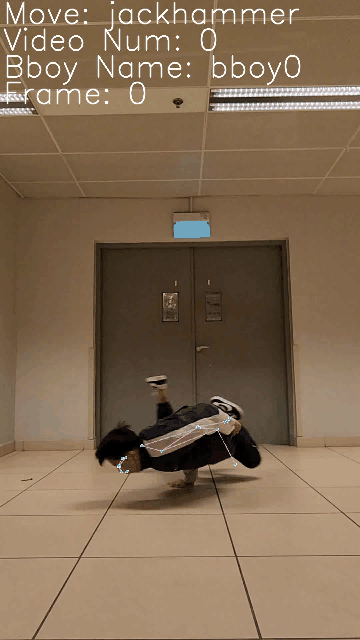

In [14]:
# Jackhammer
show_videolandmarks_name(landmark_df, 'bboy0', 'jackhammer', 0)

**Insights:**

* The move requires the wrist to turn to the maximum range of movement before each hop.
* The hopping movement is done by bending and extending the knee.
* The body spins as each hop is executed.
* The hopping movement is repetitive and it is in a rotary motion.
* The left upper limb plays a role of balancing the body while spinning and hopping.
* The hopping pace is based on the dancer's level of fatigue.

### Third Move: "handhop"

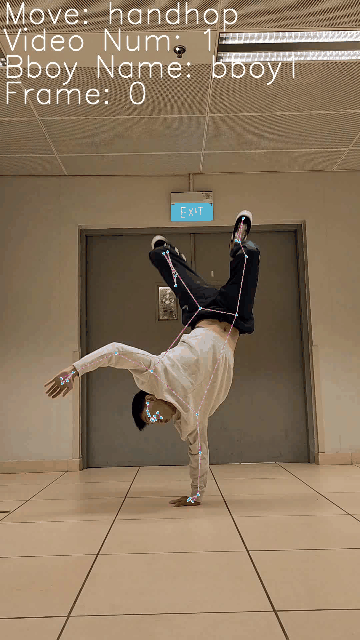

In [15]:
# Handhop

show_videolandmarks_name(landmark_df, 'bboy1', 'handhop', 1)

**Insights:**

* The hopping movement is repetitive.
* The hopping movement is done by bending and extending the knee.
* The left upper limb plays a role of balancing the body while spinning and hopping.
* The landing of the right upper limb on each hop is dependent on how each kick is executed as well as the balancing done across all the body parts.
* The hopping pace is based on the dancer's level of fatigue.

### Plot Landmarks In 3D

### Create User Defined Function: plot_3d_pose
---

* Display the selected frame and landmarks in 3D.




**plot_3d_pose**

Parameters:

* df
* bboy_name
* move_name
* video_num
* frame

Function:

1. Filter the DataFrame corresponding to the provided parameters.
2. Retrieves the pose data from the filtered DataFrame. This includes the coordinates of different landmarks.
3. Capture the specified frame from the video.
4. Saves the captured frame as a PNG image.
5. Display the captured frame and 3D plot with the extracted data. 

In [16]:
# Define connections between body parts
body_part_connections = [
    ('nose', 'mouth_left'),
    ('mouth_left', 'mouth_right'),
    ('mouth_right', 'nose'),
    ('left_shoulder', 'right_shoulder'),
    ('right_shoulder', 'right_hip'),
    ('right_hip', 'left_hip'),
    ('left_hip', 'left_shoulder'),
    ('left_shoulder', 'left_elbow'),
    ('left_elbow', 'left_wrist'),
    ('right_shoulder', 'right_elbow'),
    ('right_elbow', 'right_wrist'),
    ('left_hip', 'left_knee'),
    ('left_knee', 'left_ankle'),
    ('right_hip', 'right_knee'),
    ('right_knee', 'right_ankle')
]


def plot_3d_pose(df, bboy_name, move_name, video_num, frame):
    # Filter the DataFrame corresponding to the provided parameters
    pose_data = df[(df['bboy_name'] == bboy_name) &
                   (df['move_name'] == move_name) &
                   (df['video_num'] == video_num) &
                   (df['frame'] == frame)]
    
    # If there is no data for the frame, return
    if pose_data.empty:
        print("No data for the specified parameters.")
        return
    
    # Get the first row (since the data has already filtered to the specific frame)
    pose = pose_data.iloc[0]
    
    # Get the full video file path
    video_file_path = os.path.join(current_directory, pose['videolandmarks_path'])
    
    # Capture the frame from the video
    cap = cv2.VideoCapture(video_file_path)
    cap.set(cv2.CAP_PROP_POS_FRAMES, frame)
    ret, image = cap.read()
    cap.release()
    
    if not ret:
        print("Failed to capture frame from video.")
        return
    
    # Create a 3D plot
    fig = plt.figure(figsize=(20, 10))
    
    # Add a subplot for the frame image
    ax_img = fig.add_subplot(121)
    ax_img.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    ax_img.axis('off')  # Turn off axis for image
    
    # Add a subplot for the 3D pose
    ax_3d = fig.add_subplot(122, projection='3d')
    
    # Set the view angle for the 3D pose
    ax_3d.view_init(elev=310, azim=-90)  # Adjust 'elev' and 'azim' to change the view

    
    # Plot each body part and connect them
    for part1, part2 in body_part_connections:
        x_vals = [pose[f'{part1}_x'], pose[f'{part2}_x']]
        y_vals = [pose[f'{part1}_y'], pose[f'{part2}_y']]
        z_vals = [pose[f'{part1}_z'], pose[f'{part2}_z']]
        
        # Plot the body parts
        ax_3d.scatter(x_vals, y_vals, z_vals)
        
        # Connect the body parts
        ax_3d.plot(x_vals, y_vals, z_vals)
        
    # Set labels and title for the 3D pose
    ax_3d.set_xlabel('X')
    ax_3d.set_ylabel('Y')
    ax_3d.set_zlabel('Z')
    ax_3d.set_title(f'{bboy_name} - {move_name} (Video {video_num}, Frame {frame})')
    
    # Show the plot
    plt.show()

### Extracted Video Frame and Plot Landmark in 3D for "cc"

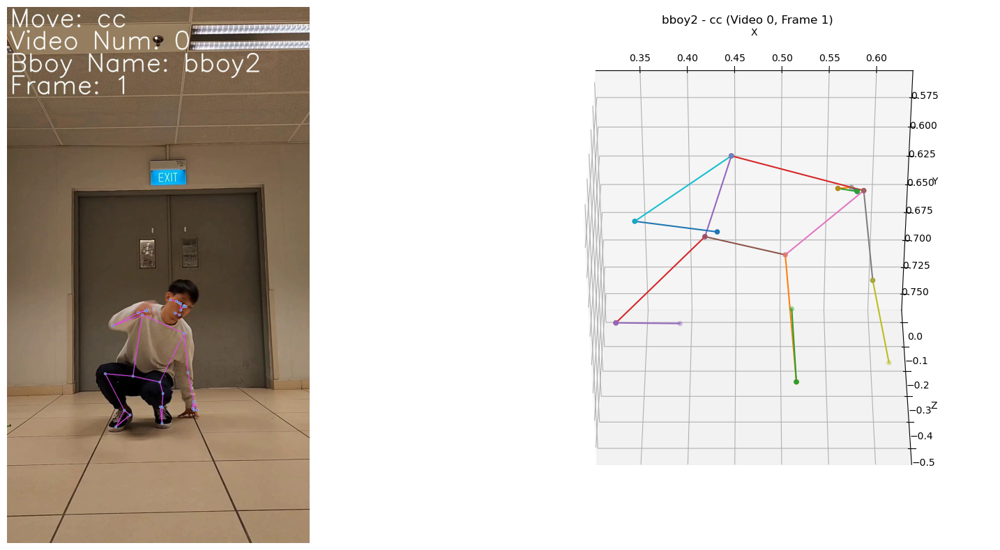

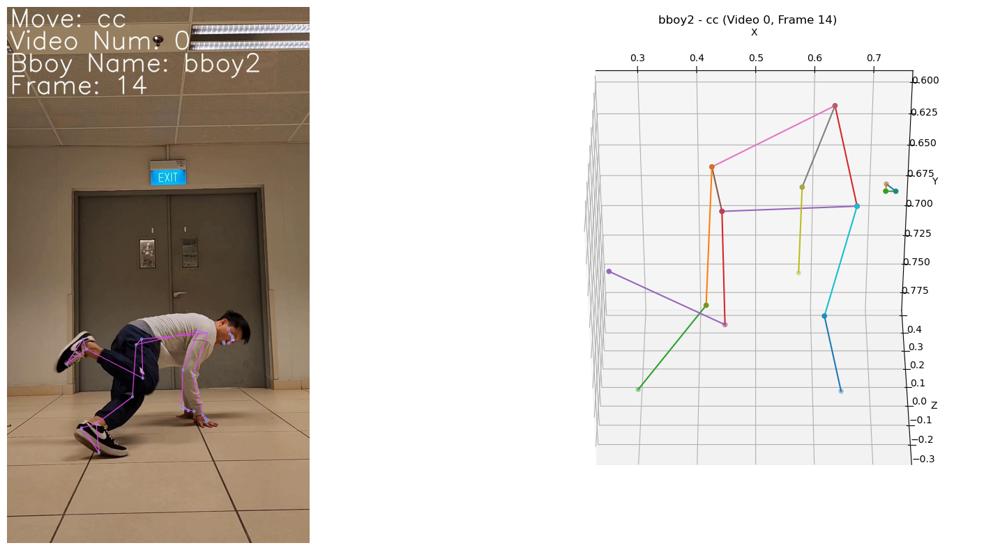

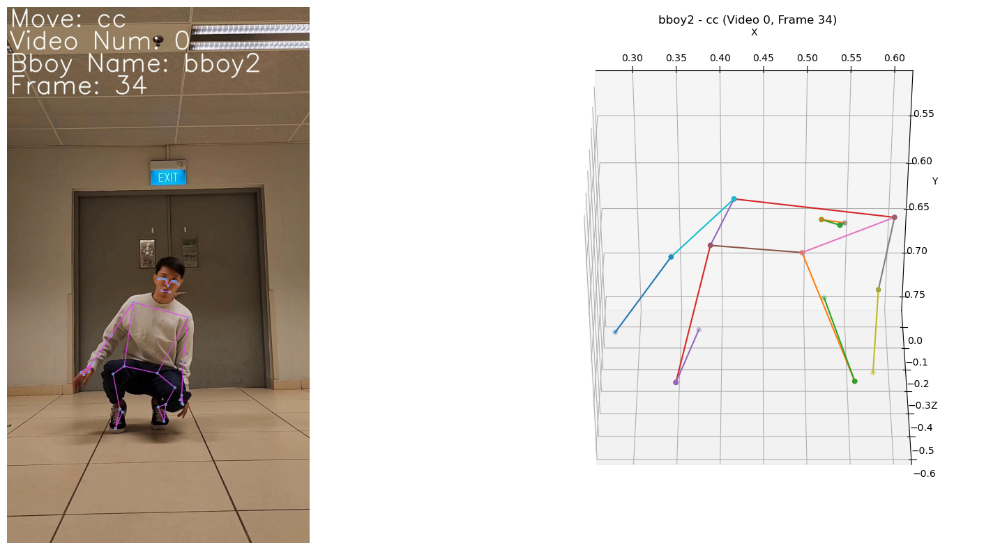

In [17]:
# cc
plot_3d_pose(landmark_df, "bboy2", "cc", 0, 1)
plot_3d_pose(landmark_df, "bboy2", "cc", 0, 14)
plot_3d_pose(landmark_df, "bboy2", "cc", 0, 34)

**Insights:**

* The landmarks value changes significantly in the x and z axis as the right upper limb and head swung to the left whereas the left lower limb kicked forward and diagonally to the right.
* The change in y axis is observed as the left hand is in contact the ground and right lower limb is bent upwards into a pose.
* The poses in the first and last frame are identical which is the squat position but with different landmark values.

### Extracted Video Frame and Plot Landmark in 3D for "jackhammer"

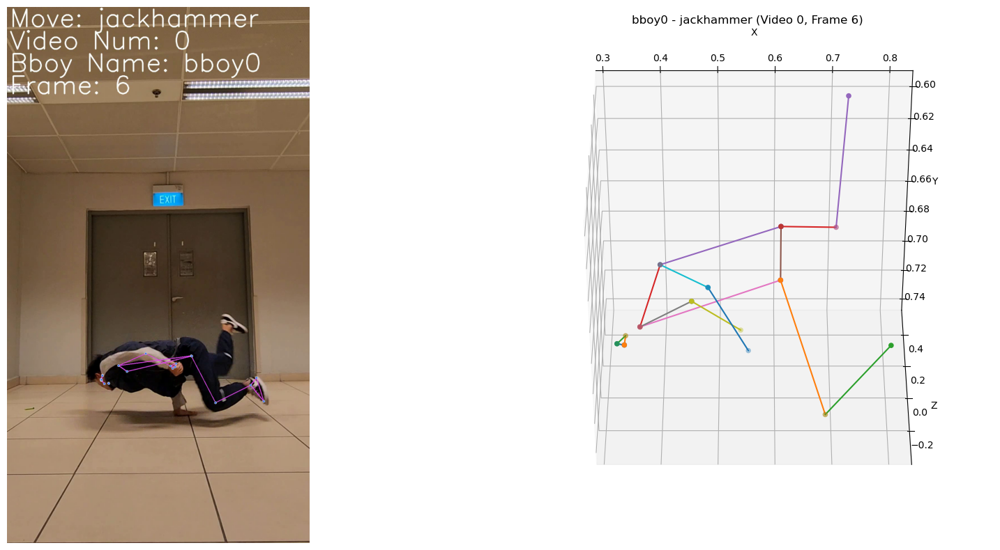

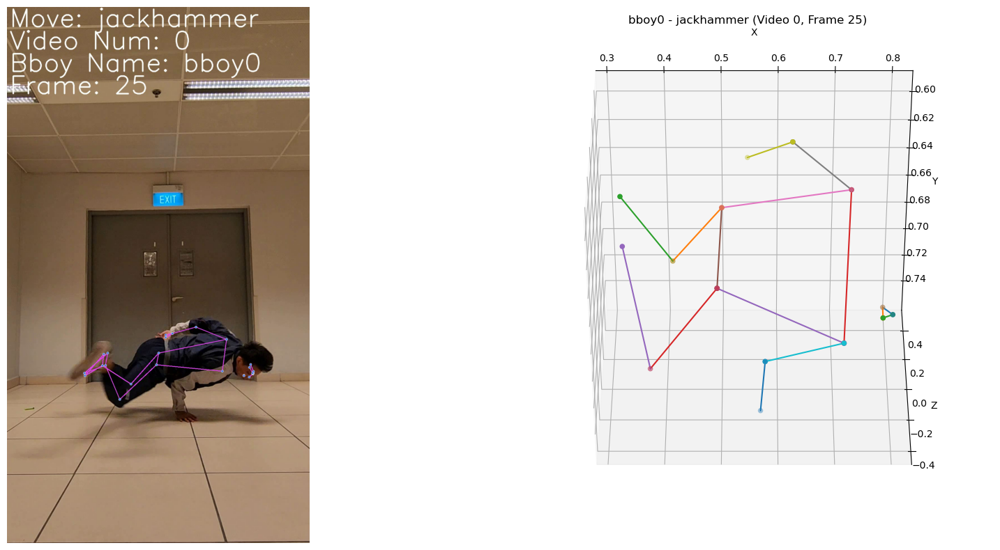

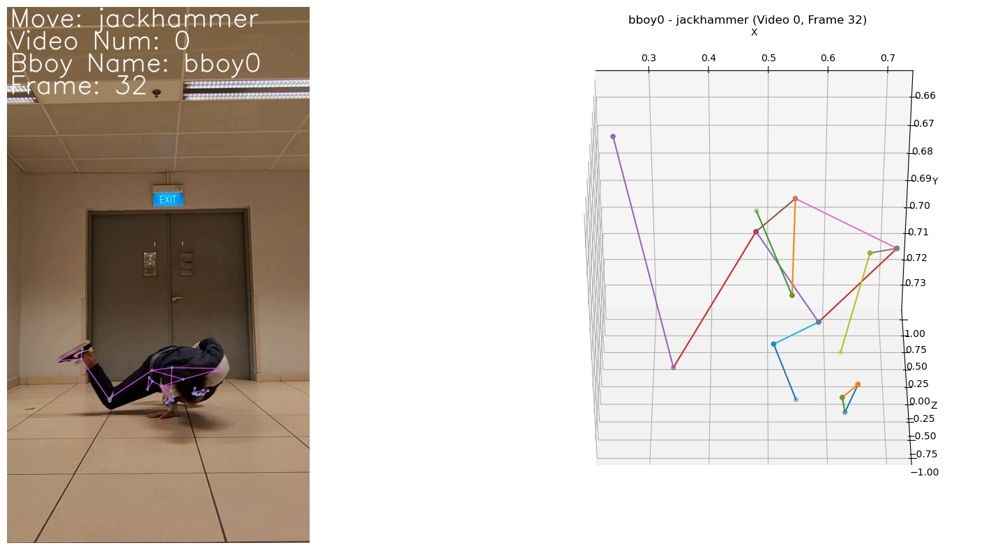

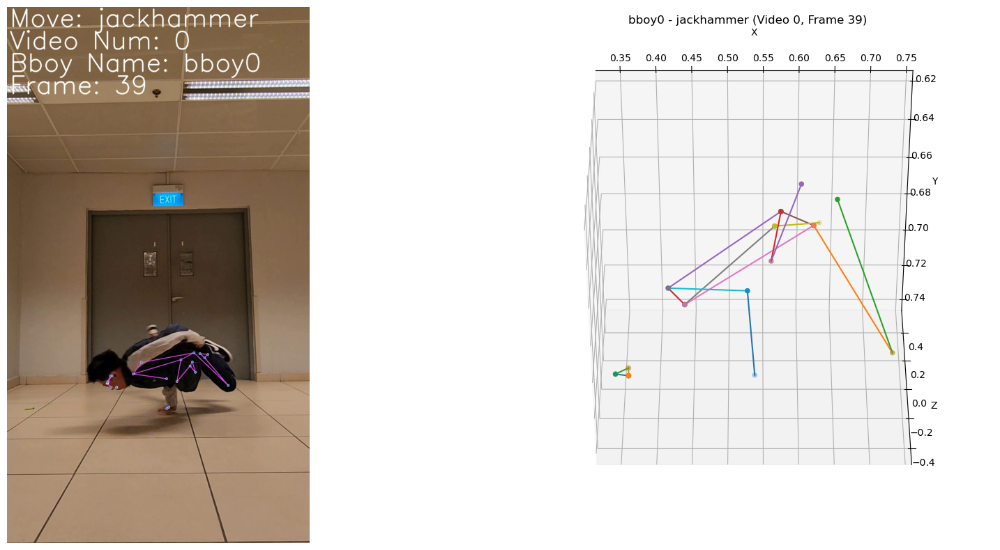

In [18]:
# jackhammer
plot_3d_pose(landmark_df, "bboy0", "jackhammer", 0, 6)
plot_3d_pose(landmark_df, "bboy0", "jackhammer", 0, 25)
plot_3d_pose(landmark_df, "bboy0", "jackhammer", 0, 32)
plot_3d_pose(landmark_df, "bboy0", "jackhammer", 0, 39)

**Insights:**

* All the landmarks of x and z axis values varied across the different frames due to the spinning movement of this move along the axis.
* In the last frame where it shows the variations in the y axis when the dancer is in mid air, it is observed that all the landmarks in the y axis increases.

### Extracted Video Frame and Plot Landmark in 3D for "handhop"

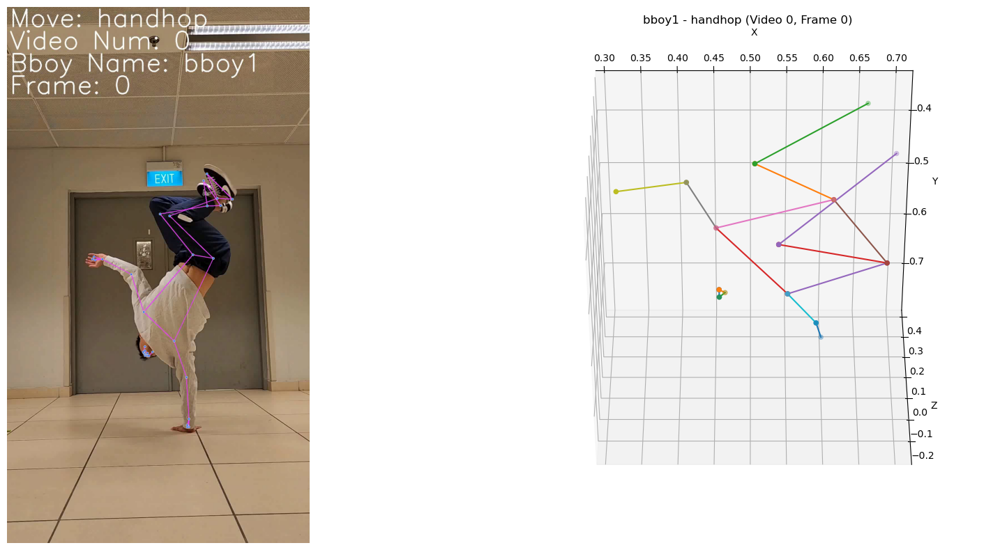

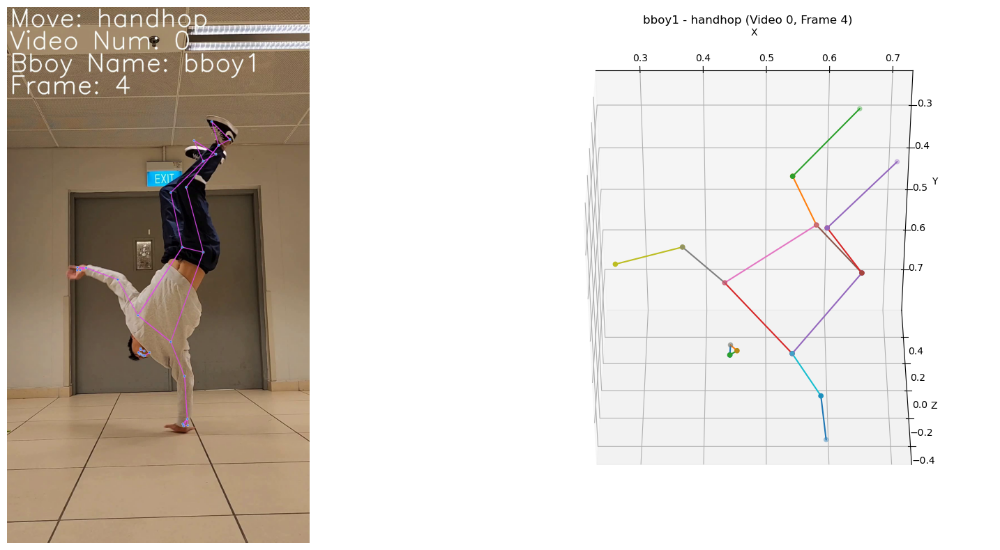

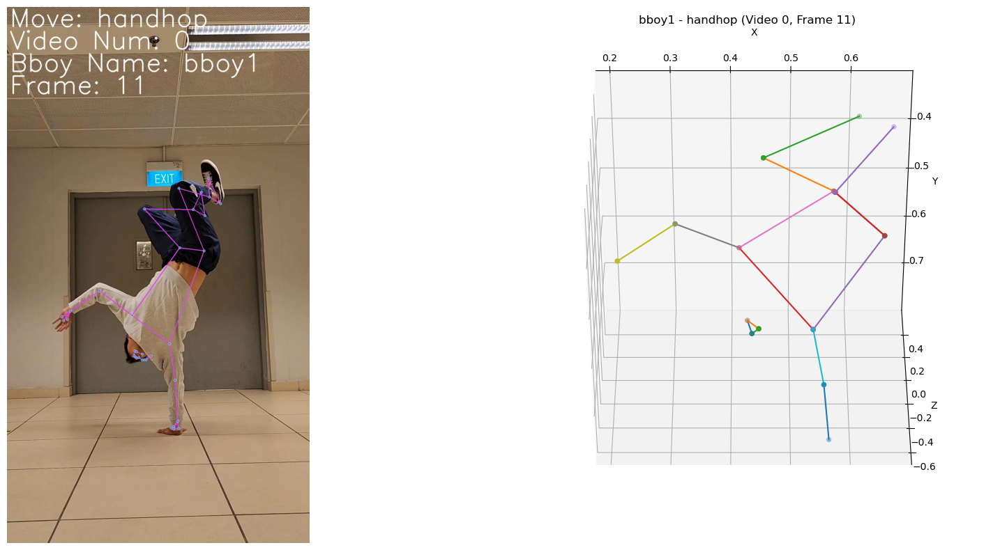

In [19]:
# handhop
plot_3d_pose(landmark_df, "bboy1", "handhop", 0, 0)
plot_3d_pose(landmark_df, "bboy1", "handhop", 0, 4)
plot_3d_pose(landmark_df, "bboy1", "handhop", 0, 11)

**Insights:**

* It is observed in the second frame that when the dancer body moves away from the ground, the lower limbs landmark values in y axis are at their maximum before returning to its original pose in the third frame which the knee is bent in preparing for the next hop.
* The landmark values in the x and z axis changes as the dancer lands on different spot after each hop is executed.
* The left upper limb landmark value may vary across the x , y and z axis as the dancer is balancing himself.
* The landmark values in the y axis for mouth is higher than the eyes at all time which signify that the dancer's body is inverted.


### Check for Zero Value

In [20]:
#Check for Zero Value

# Columns to check on
zero_columns = [
    'nose_x', 'nose_y', 'nose_z', 'nose_v',
    'mouth_left_x', 'mouth_left_y', 'mouth_left_z', 'mouth_left_v',
    'mouth_right_x', 'mouth_right_y', 'mouth_right_z', 'mouth_right_v',
    'right_shoulder_x', 'right_shoulder_y', 'right_shoulder_z', 'right_shoulder_v',
    'right_elbow_x', 'right_elbow_y', 'right_elbow_z', 'right_elbow_v',
    'right_wrist_x', 'right_wrist_y', 'right_wrist_z', 'right_wrist_v',
    'left_shoulder_x', 'left_shoulder_y', 'left_shoulder_z', 'left_shoulder_v',
    'left_elbow_x', 'left_elbow_y', 'left_elbow_z', 'left_elbow_v',
    'left_wrist_x', 'left_wrist_y', 'left_wrist_z', 'left_wrist_v',
    'right_hip_x', 'right_hip_y', 'right_hip_z', 'right_hip_v',
    'right_knee_x', 'right_knee_y', 'right_knee_z', 'right_knee_v',
    'right_ankle_x', 'right_ankle_y', 'right_ankle_z', 'right_ankle_v',
    'left_hip_x', 'left_hip_y', 'left_hip_z', 'left_hip_v',
    'left_knee_x', 'left_knee_y', 'left_knee_z', 'left_knee_v',
    'left_ankle_x', 'left_ankle_y', 'left_ankle_z', 'left_ankle_v'
]

# Filter rows where columns mentioned in zero_columns have zero values
landmark_zero = landmark_df[(landmark_df[zero_columns] == 0).all(axis=1)]

# Reset the index of the new DataFrame
landmark_zero.reset_index(drop=True, inplace=True)
landmark_zero = landmark_zero.drop(columns=['bboy_name','videolandmarks_path','videolandmarks_name','video_name'])

In [21]:
# Groupby move_name and video_num to find out which video_num has zero value
landmark_zero_gb_move_vid_cnt = landmark_zero.groupby(['move_name', 'video_num']).size().reset_index(name='count')


landmark_zero_gb_move_vid_cnt

,move_name,video_num,count
0,handhop,5,1
1,jackhammer,0,2
2,jackhammer,1,3
3,jackhammer,2,3
4,jackhammer,3,3
5,jackhammer,4,3
6,jackhammer,5,3
7,jackhammer,6,2
8,jackhammer,7,2


In [22]:
# Groupby move_name to aggregate the total count of zero for each move

landmark_zero_gb_move_cnt = landmark_zero.groupby('move_name').size().reset_index(name='count')

landmark_zero_gb_move_cnt

,move_name,count
0,handhop,1
1,jackhammer,21


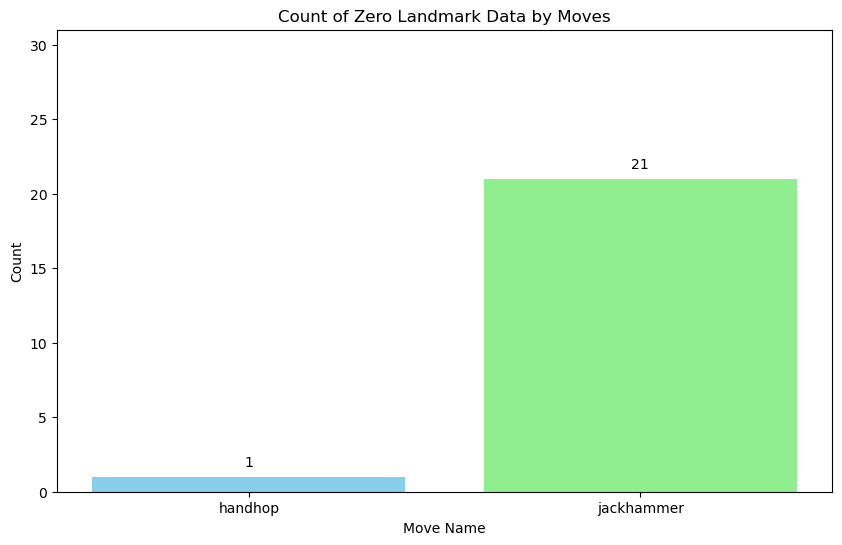

In [23]:
# Bar plot to display number of zeros values for each move

# Data from the landmark_zero_gb_move_cnt DataFrame
move_names = landmark_zero_gb_move_cnt["move_name"]
count = landmark_zero_gb_move_cnt["count"]

# color_dict to map move names to colors
color_dict = {
    'handhop': 'skyblue',
    'jackhammer': 'lightgreen',
}

# Create a list of colors based on move names
colors = [color_dict.get(move, 'gray') for move in move_names]

# Create a bar plot
plt.figure(figsize=(10, 6))
bars = plt.bar(move_names, count, color=colors)
plt.xlabel('Move Name')
plt.ylabel('Count')
plt.title('Count of Zero Landmark Data by Moves')

# Add count values on top of the bars
for bar, value in zip(bars, count):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 0.5, str(value), ha='center', va='bottom')

# Set the y-axis limit to ensure the label is visible
max_count = max(count)
plt.ylim(0, max_count + 10)

plt.show()

* Zero values are observed which signify that there are landmark values that have not been captured by the Mediapipe algorithm. 

* Out of all the attempts of the 3 moves , jackhammer has the most number of zero values for all the landmarks in x, y ,z axis.

* This might be due to the rapid movement and angles of filming the moves which made difficult for the Mediapipe algorithm to track the landmarks accurately.

### Create Dataframe range_motion_df
---

range_motion_df contains 

* move_name : Name of the move
* video_num : Video attempt number
* Difference between the max and min value for each landmark in x, y , x coordinate x,y,z coordinates in each video attempt

In [24]:
# create range_motion_df

# Extracting the coordinate columns
coordinate_columns = [col for col in landmark_df.columns if col.endswith(('_x', '_y', '_z'))]

# Groupby 'move_name' and 'video_num'
grouped_data = landmark_df.groupby(['move_name', 'video_num'])

# Define a function to calculate the range of motion within each group
def range_of_motion(group):
    return group.max() - group.min()

# Calculate the range of motion for each coordinate within each group
range_motion_df = grouped_data[coordinate_columns].apply(range_of_motion)

# Reset index to make 'move_name' and 'video_num' as columns
range_motion_df = range_motion_df.reset_index()

### Check First 5 Rows of range_motion_df

In [25]:
range_motion_df.head()

,move_name,video_num,nose_x,nose_y,nose_z,mouth_left_x,mouth_left_y,mouth_left_z,mouth_right_x,mouth_right_y,mouth_right_z,right_shoulder_x,right_shoulder_y,right_shoulder_z,right_elbow_x,right_elbow_y,right_elbow_z,right_wrist_x,right_wrist_y,right_wrist_z,left_shoulder_x,left_shoulder_y,left_shoulder_z,left_elbow_x,left_elbow_y,left_elbow_z,left_wrist_x,left_wrist_y,left_wrist_z,right_hip_x,right_hip_y,right_hip_z,right_knee_x,right_knee_y,right_knee_z,right_ankle_x,right_ankle_y,right_ankle_z,left_hip_x,left_hip_y,left_hip_z,left_knee_x,left_knee_y,left_knee_z,left_ankle_x,left_ankle_y,left_ankle_z
0,cc,0,0.365303,0.125575,0.795516,0.331211,0.114860,0.784719,0.348822,0.111000,0.716120,0.328019,0.087069,0.325140,0.339969,0.123794,0.424510,0.453761,0.211097,0.722803,0.149474,0.066265,0.802250,0.083635,0.067334,0.802054,0.169792,0.078471,0.864325,0.073607,0.091408,0.204008,0.216334,0.106446,0.555321,0.160359,0.115987,0.855887,0.116797,0.070295,0.203449,0.172367,0.090105,0.906025,0.249053,0.058268,1.359299
1,cc,1,0.242955,0.104816,1.057237,0.219759,0.092841,1.019207,0.235061,0.090925,0.969899,0.278351,0.083119,0.547389,0.333081,0.134989,0.629783,0.526965,0.240986,0.969100,0.086027,0.049106,0.943449,0.131823,0.044408,0.913610,0.205866,0.071712,1.024921,0.064433,0.084995,0.176224,0.216006,0.110127,0.610892,0.187652,0.122971,0.940129,0.140223,0.069528,0.175805,0.195220,0.092416,0.883897,0.245821,0.059978,1.440400
2,cc,2,0.271457,0.123349,1.399650,0.242452,0.109798,1.355050,0.259876,0.106494,1.300286,0.324610,0.085642,0.747454,0.413063,0.165402,0.669354,0.614430,0.278542,0.833358,0.096900,0.067232,1.213851,0.079035,0.043788,1.246037,0.089136,0.040325,1.364263,0.126676,0.091982,0.179595,0.268604,0.122376,0.646046,0.172972,0.137817,1.307490,0.096055,0.078570,0.178983,0.222342,0.080360,0.942724,0.226555,0.095559,1.430912
3,cc,3,0.256236,0.124908,1.271497,0.236433,0.112644,1.240742,0.255374,0.109359,1.207315,0.316452,0.097202,0.782080,0.360149,0.119507,0.796246,0.476920,0.223544,1.188571,0.096118,0.076275,1.186490,0.149632,0.072225,1.238645,0.206096,0.111858,1.403370,0.117457,0.085562,0.168280,0.209256,0.124420,0.665271,0.152076,0.164862,1.403744,0.128726,0.072617,0.168048,0.273791,0.079859,1.115747,0.235491,0.159517,1.947627
4,cc,4,0.451061,0.155008,0.960640,0.409463,0.143029,0.944757,0.428692,0.137450,0.890705,0.381947,0.088369,0.485988,0.394939,0.122535,0.630503,0.535779,0.195590,0.834381,0.216132,0.097531,0.979599,0.132296,0.110698,1.047208,0.228866,0.157825,1.209544,0.116919,0.104217,0.214451,0.234514,0.112104,0.541426,0.174359,0.170009,1.105777,0.107271,0.070184,0.214301,0.230472,0.132634,0.832074,0.255494,0.180899,1.344222


### Basic Stats for range_motion_df

In [26]:
# Stats for all the range_motion_df data
range_motion_df.describe()

,video_num,nose_x,nose_y,nose_z,mouth_left_x,mouth_left_y,mouth_left_z,mouth_right_x,mouth_right_y,mouth_right_z,right_shoulder_x,right_shoulder_y,right_shoulder_z,right_elbow_x,right_elbow_y,right_elbow_z,right_wrist_x,right_wrist_y,right_wrist_z,left_shoulder_x,left_shoulder_y,left_shoulder_z,left_elbow_x,left_elbow_y,left_elbow_z,left_wrist_x,left_wrist_y,left_wrist_z,right_hip_x,right_hip_y,right_hip_z,right_knee_x,right_knee_y,right_knee_z,right_ankle_x,right_ankle_y,right_ankle_z,left_hip_x,left_hip_y,left_hip_z,left_knee_x,left_knee_y,left_knee_z,left_ankle_x,left_ankle_y,left_ankle_z
count,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000,24.000000
mean,3.500000,0.422752,0.324582,1.189076,0.405849,0.317432,1.127798,0.410910,0.317331,1.117049,0.408033,0.310042,0.835733,0.423638,0.351927,0.859482,0.506271,0.406420,1.074387,0.351292,0.300130,0.889243,0.367627,0.330857,0.885125,0.417773,0.372079,1.052934,0.292423,0.299479,0.223177,0.403307,0.338623,0.731143,0.441391,0.363764,1.203690,0.312385,0.293676,0.222785,0.405242,0.333925,0.838674,0.451534,0.351067,1.326287
std,2.340568,0.299528,0.322956,0.535341,0.297656,0.324984,0.512385,0.296306,0.325743,0.523080,0.256275,0.319372,0.427955,0.194455,0.301761,0.392912,0.193861,0.287206,0.400544,0.302024,0.313988,0.355061,0.271665,0.304082,0.312976,0.252192,0.293320,0.338599,0.270880,0.310481,0.095737,0.280048,0.322651,0.189076,0.353611,0.281072,0.334260,0.253683,0.309577,0.095597,0.270593,0.325709,0.279504,0.304240,0.304016,0.547797
min,0.000000,0.049673,0.013597,0.280406,0.043375,0.011315,0.280731,0.047629,0.011150,0.261885,0.072677,0.021385,0.220825,0.062122,0.020645,0.263031,0.076875,0.013377,0.363695,0.061279,0.008326,0.277035,0.079035,0.043788,0.340389,0.087635,0.040325,0.304077,0.027969,0.024121,0.080615,0.085515,0.055078,0.355634,0.134947,0.115987,0.755538,0.030932,0.025199,0.080786,0.093168,0.038344,0.317018,0.106598,0.058268,0.496165
25%,1.750000,0.143310,0.054449,0.770372,0.138840,0.046459,0.752301,0.134357,0.047874,0.703303,0.170030,0.072025,0.483539,0.298679,0.123692,0.603432,0.371247,0.220433,0.805719,0.096705,0.066232,0.503842,0.130805,0.081202,0.673182,0.206039,0.119187,0.842119,0.081441,0.040806,0.161401,0.207731,0.094629,0.643699,0.172037,0.144855,0.896001,0.117581,0.046389,0.160205,0.191474,0.080235,0.599193,0.232747,0.102842,0.726467
50%,3.500000,0.303225,0.134915,1.189604,0.271459,0.123257,1.129974,0.287413,0.119532,1.110433,0.326146,0.087719,0.764767,0.404001,0.169304,0.764271,0.555673,0.266983,1.032854,0.178165,0.088225,0.968996,0.273301,0.164166,0.918774,0.388799,0.215191,1.037356,0.122066,0.092869,0.187303,0.266389,0.112581,0.680214,0.194465,0.168956,1.227047,0.151542,0.081837,0.186996,0.256654,0.113089,0.909217,0.266556,0.162310,1.376886
75%,5.250000,0.772340,0.730420,1.670666,0.757013,0.726978,1.576254,0.756235,0.727240,1.598083,0.695044,0.709593,1.284562,0.600247,0.723562,1.224122,0.636107,0.752417,1.340688,0.717419,0.701879,1.197851,0.681059,0.718010,1.185307,0.691578,0.740941,1.330010,0.618870,0.698633,0.328011,0.752366,0.746234,0.804065,0.879921,0.708960,1.413275,0.611195,0.686578,0.327415,0.740732,0.749428,1.094786,0.837306,0.728319,1.864919
max,7.000000,0.859393,0.758584,1.932805,0.842767,0.757808,1.816314,0.842047,0.759736,1.836350,0.772435,0.739731,1.507900,0.747535,0.744395,1.487210,0.765764,0.775779,2.183591,0.798042,0.724144,1.314530,0.783194,0.735921,1.338714,0.772196,0.759899,1.565169,0.710322,0.713851,0.373172,0.793399,0.774404,1.251923,0.951553,0.752887,2.033032,0.698660,0.704197,0.372475,0.786346,0.768569,1.189883,0.917403,0.746298,2.132217


### Identify Landmarks with Highest Median Value in range_motion_df
----

### Boxplot

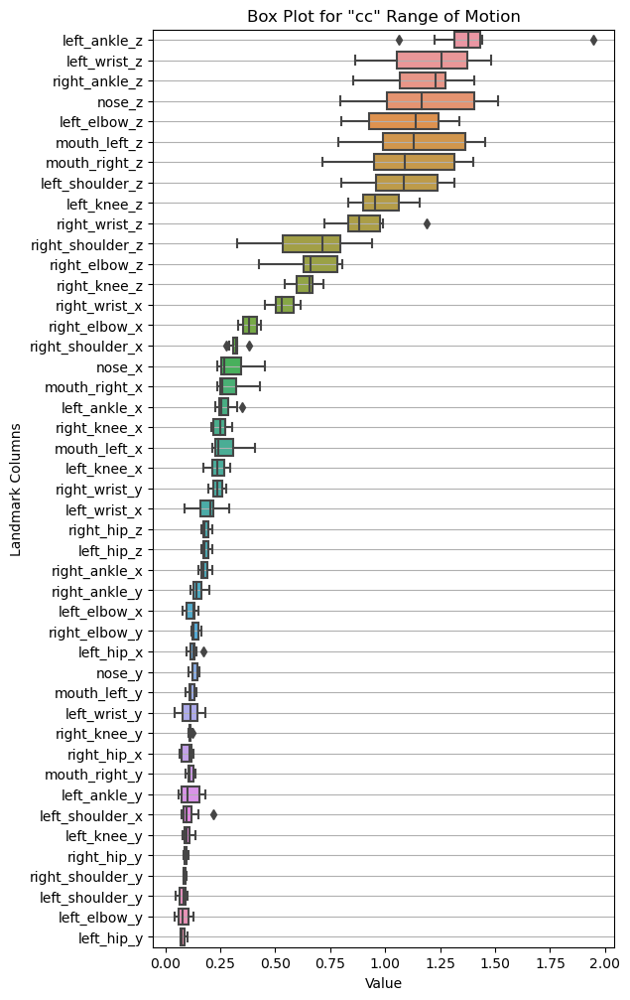

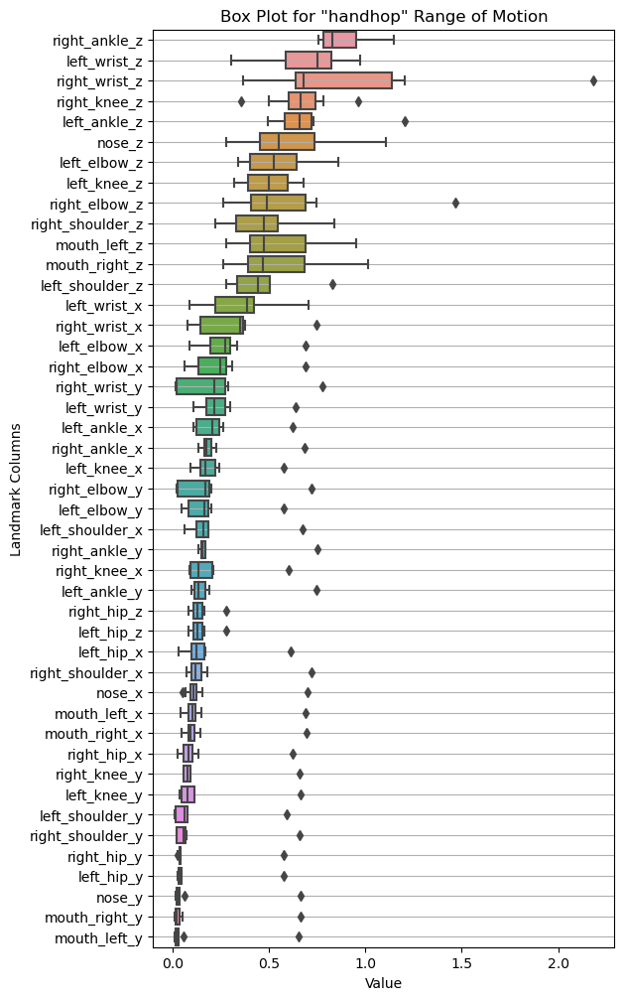

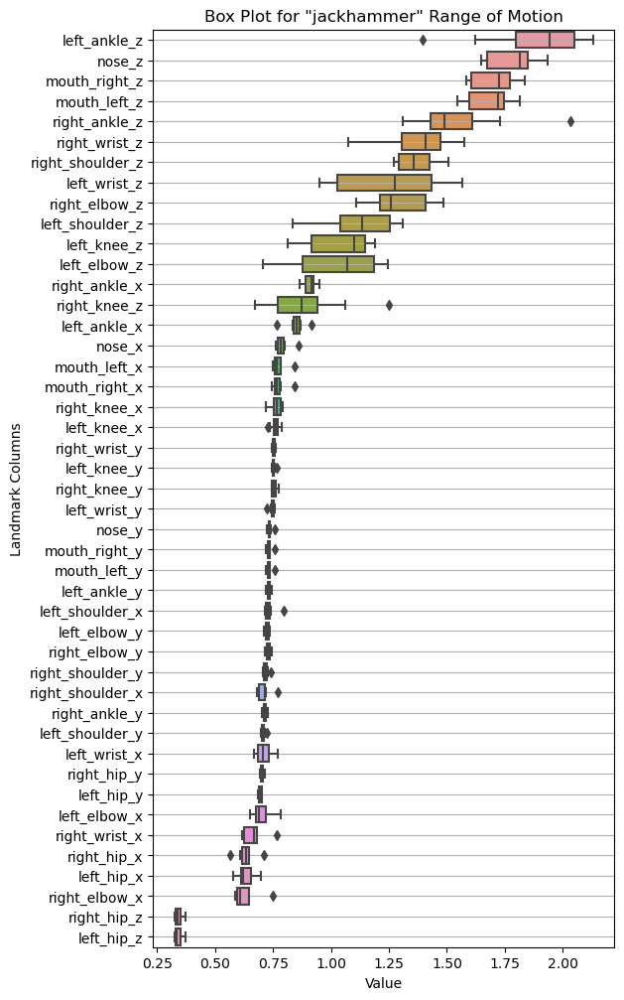

In [27]:
exclude_columns = ["move_name", "video_num"]

# List of all columns in the DataFrame
all_columns = range_motion_df.columns.tolist()

# Create landmark_columns by excluding the columns in exclude_columns
landmark_columns = [col for col in all_columns if col not in exclude_columns]

# Create box plots for each "move_name"
for move_name in range_motion_df["move_name"].unique():
    subset = range_motion_df[range_motion_df["move_name"] == move_name]
    subset = subset[landmark_columns]  # Select only landmark columns
    
    
    # Sort columns based on their median values in descending order
    subset = subset[subset.median().sort_values(ascending=False).index]    
    plt.figure(figsize=(6, 12))  # Adjust the figsize for vertical box plots
    ax = sns.boxplot(data=subset, orient='h')  # Set orient='h' for horizontal box plots
    ax.yaxis.grid(True)  # Enable horizontal gridlines
    plt.title(f'Box Plot for "{move_name}" Range of Motion')
    plt.xlabel('Value')  # Swap xlabel and ylabel for horizontal orientation
    plt.ylabel('Landmark Columns')
    plt.show()

**Handhop:**

* The boxplot for right_wrist_z suggest that the distribution might be skewed to the right. This is unsuprising as the dancer lands on different points in the z axis after every hop (landing front and back) and calculation for range_motion_df takes the maximum and minimum landmark value in the z axis among the 60 frames.

* The above observations were also seen across other landmarks in the z axis such as the right_ankle_z, nose_z , right_elbow_z , mouth_right_z, mouth_left_z.

* The wide spread of these landmarks also indicates that there are more Variabilities as the landing after each hop is different. However, this might actually be beneficial when training the different models as the test data also has high variability.


* The boxplot for left_wrist_z suggest that its distribution is skewed to the left which might be due to the counter balancing for the body done by the dancer when landing after every hop.

* There are quite a few outliers present in the plot, especially for the landmarks in the z axis. This indicates that there is a significant variation in how the handhop is performed, or it could suggest moments where the dancer's body parts are at the peak of their movement. 



**Jackhammer:**

* The boxplots for nose_z, mouth_right_z, mouth left_z, left_knee_z and left_elbow_z suggest that the distributions are skewed to the left. These might be due to the body is moving nearer to the minimum value in the z axis of the landmarks.


* The spread for for left_wrist_z is wide which indicates that there are more variability which might be due to the counter balancing done with the left upper limb. 


* The outliers in left_ankle_z, right_ankle_z and right_knee_z might be caused by the increased level of fatigue in the dancer as the forms in executing the move may deteriorate.

* Similar to handhop, introducing variabilities may help improve the model performances.


**CC:**

* Boxplot for nose_z, mouth_right_z, mouth left_z, left_knee_z and left_elbow_z suggest that the distributions are skewed to the right. These might be due to the body is moving nearer to the minimum value in the z axis of the landmarks.


* The spread for for nose_z, mouth_right_z, mouth left_z are wide which indicates that there are more variabilities in how the dancer moves his head when executing the move.


* The outliers in left_ankle_z, right_wrist_z and right_shoulder_x might be caused by the increased level of fatigue in the dancer as the forms in executing the move may detiorate.

* Same as the handhop and jackhammer, introducing variabilities may help improve the model performances.

**Insights:**


* The boxplot chart for move "cc" is seen to be the most consistent among the 3 moves as the the box for most landmarks are shorter.


* The boxplot chart for move "jackhammer" is seen to be the least consistent among the 3 moves as there are more landmark boxes that are longer than the other 2.

* The move "handhop" has the most number of outliers among the moves. However, they are still representative of the true range of the dance move as the movements seen in the videos are still within the context of handhop. Same applies to the dance move jackhammer and cc. Hence, the outliers will not be dropped or imputated.

* The high variabilities observed in the data, as observed across the boxplots, suggests the need for more complex models. This is because dance move classification inherently involves understanding complex temporal relationships within time-series data.


### Create User Defined Function: calculate_median_landmarks_for_move
---


* Obtain top 20 median range of motion values



**calculate_median_landmarks_for_move**

Parameters:

* range_motion_df
* move_name



Function:

1. Filter the range_motion_df corresponding to move_name.
2. Calculate the median values for each landmark column.
3. Return Top 20 median range of motion.

In [28]:
def calculate_median_landmarks_for_move(range_motion_df, move_name):
    # Filter the DataFrame for the specified move_name
    subset_df = range_motion_df[range_motion_df["move_name"] == move_name]
    
    # Select only the landmark columns
    landmark_columns = subset_df.columns.difference(["move_name", "video_num"])
    
    # Calculate the median for each landmark
    median_landmarks = subset_df[landmark_columns].median()
    
    # Create a DataFrame with the median values
    median_df = pd.DataFrame({"Landmark": median_landmarks.index, "Median": median_landmarks.values})
    
    # Sort the DataFrame by highest to lowest median values
    median_df = median_df.sort_values(by="Median", ascending=False).reset_index(drop=True)
    
    return median_df.head(20)  # Return the top 20 median landmarks

### Top 20 Median Range of Motion for "cc"

In [29]:
move_name = "cc"
median_cc_df = calculate_median_landmarks_for_move(range_motion_df, move_name)
median_cc_df

,Landmark,Median
0,left_ankle_z,1.377516
1,left_wrist_z,1.254369
2,right_ankle_z,1.227047
3,nose_z,1.164367
4,left_elbow_z,1.139043
5,mouth_left_z,1.129974
6,mouth_right_z,1.088607
7,left_shoulder_z,1.083044
8,left_knee_z,0.953322
9,right_wrist_z,0.883148


### Top 20 Median Range of Motion for "jackhammer"

In [30]:
move_name = "jackhammer"
median_jackhammer_df = calculate_median_landmarks_for_move(range_motion_df, move_name)
median_jackhammer_df

,Landmark,Median
0,left_ankle_z,1.942517
1,nose_z,1.813783
2,mouth_right_z,1.724576
3,mouth_left_z,1.719640
4,right_ankle_z,1.487671
5,right_wrist_z,1.407652
6,right_shoulder_z,1.358601
7,left_wrist_z,1.277347
8,right_elbow_z,1.259631
9,left_shoulder_z,1.132269


### Top 20 Median Range of Motion for "handhop"

In [31]:
move_name = "handhop"
median_handhop_df = calculate_median_landmarks_for_move(range_motion_df, move_name)
median_handhop_df

,Landmark,Median
0,right_ankle_z,0.830790
1,left_wrist_z,0.754004
2,right_wrist_z,0.680760
3,right_knee_z,0.663442
4,left_ankle_z,0.657072
5,nose_z,0.551423
6,left_elbow_z,0.525726
7,left_knee_z,0.499401
8,right_elbow_z,0.486923
9,right_shoulder_z,0.475239


### Common Median Landmarks and Their Values Across Range of Motions

### Venn Diagram

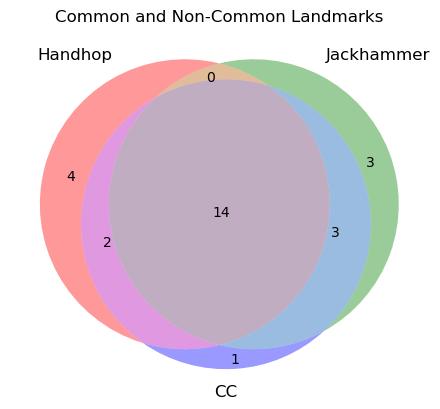

In [32]:
from matplotlib_venn import venn3

# Define the landmark sets for each move
landmarks_handhop = set(median_handhop_df["Landmark"])
landmarks_jackhammer = set(median_jackhammer_df["Landmark"])
landmarks_cc = set(median_cc_df["Landmark"])

# Create a Venn diagram
venn = venn3([landmarks_handhop, landmarks_jackhammer, landmarks_cc], 
             set_labels=("Handhop", "Jackhammer", "CC"))

# Set the title
plt.title("Common and Non-Common Landmarks")

# Display the diagram
plt.show()

### Create Dataframe combined_landmark_median_df
---

combined_landmark_median_df contains 

* Landmark : Name of landmark
* handhop : Median range of motion value
* jackhammer : Median range of motion value
* cc : Median range of motion value

In [33]:
move_names = ["handhop", "jackhammer", "cc"]
median_dfs = []

for move_name in move_names:
    median_df = calculate_median_landmarks_for_move(range_motion_df, move_name)
    median_dfs.append(median_df)

# Combine the median dataframes into a single dataframe
combined_landmark_median_df = pd.concat([df.set_index("Landmark")["Median"] for df in median_dfs], axis=1)
combined_landmark_median_df.columns = move_names  # Set the column names to move names

# Reset the index to have Landmark as a regular column
combined_landmark_median_df.reset_index(inplace=True)

# Display the combined dataframe
combined_landmark_median_df

,Landmark,handhop,jackhammer,cc
0,right_ankle_z,0.830790,1.487671,1.227047
1,left_wrist_z,0.754004,1.277347,1.254369
2,right_wrist_z,0.680760,1.407652,0.883148
3,right_knee_z,0.663442,0.872988,0.655658
4,left_ankle_z,0.657072,1.942517,1.377516
5,nose_z,0.551423,1.813783,1.164367
6,left_elbow_z,0.525726,1.071489,1.139043
7,left_knee_z,0.499401,1.100560,0.953322
8,right_elbow_z,0.486923,1.259631,0.662177
9,right_shoulder_z,0.475239,1.358601,0.714090


In [34]:
combined_landmark_median_df.shape

(27, 4)

* There are 27 landmarks featured in combined_landmark_median_df, showing the median range of motion for the top 20 across "handhop", "jackhammer", and "cc". 
* 14 landmarks common among the 3 moves.

### Further Exploratory Data Analysis
---

5 common landmarks among the dance moves, were chosen for further analysis as they are part of the top 20 median landmarks in the individual moves.



* right_wrist_x
* right_wrist_y
* right_wrist_z
* right_ankle_z
* left_ankle_z

**Applying subject matter expert's knowledge:**

All 3 moves requires substaintial movements and effort from these body parts for execution:



| **Landmark**  | **handhop** | **jackhammer** | **cc**                                         |
|---------------|-------------|----------------|------------------------------------------------|
| right_ankle_z | kick        | rotation       | kick out but   different pose from left ankle  |
| right_wrist_z | landing     | rotation       | swing                                          |
| left_ankle_z  | kick        | rotation       | kick out but   different pose from right ankle |
| right_wrist_x | landing     | rotation       | swing                                          |
| right_wrist_y | hop         | hop            | swing                                          |




### Temporal Variation Analysis
---

Temporal Variation Analysis for:

* right_wrist_x
* right_wrist_y
* right_wrist_z
* right_ankle_z
* left_ankle_z

To analyse how the positions or features of these landmarks change over time within each video, revealing the unique patterns or inconsistency in the execution.

### Create User Defined Function: plot_temporal_variation
---

* Visualizes the variation over time of a specific landmark in a selected move with heatmap




**plot_temporal_variation**

Parameters:

* landmark_df
* selected_move
* selected_landmark
* vmin
* vmax

Function:

1. Filter the DataFrame corresponding to move_name.
2. Creates a pivot table from the filtered data to effectively organizes the data for temporal analysis.
3. Display Heatmap.

In [35]:
def plot_temporal_variation(landmark_df, selected_move, selected_landmark, vmin=None, vmax=None):
    # Filtering the dataset for the selected move
    move_data = landmark_df[landmark_df['move_name'] == selected_move]

    # Creating a pivot table for temporal analysis
    pivot_data = move_data.pivot_table(index='video_num', columns='frame', values=selected_landmark)

    # Plotting the temporal variation for each attempt of the selected move
    plt.figure(figsize=(12, 4))  # Adjusted height here
    sns.heatmap(pivot_data, cmap='viridis', vmin=vmin, vmax=vmax)
    plt.title(f'Temporal Variation for {selected_landmark} in "{selected_move}"')
    plt.xlabel('Frame Number')
    plt.ylabel('Attempt (Video Number)')
    plt.show()

### Temporal Variation of right_wrist_x

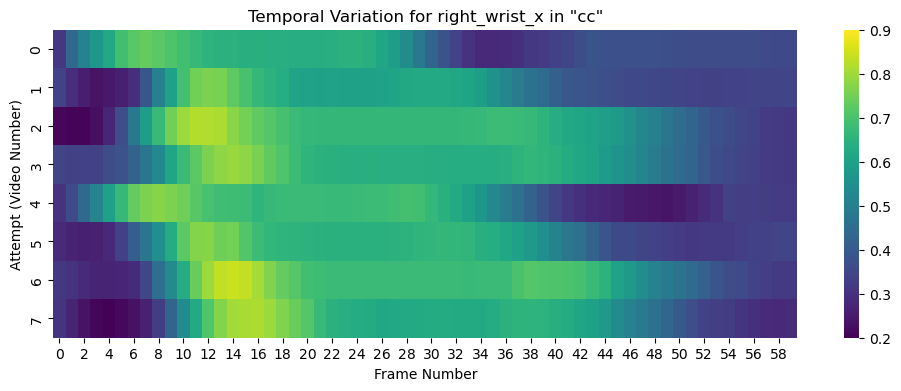

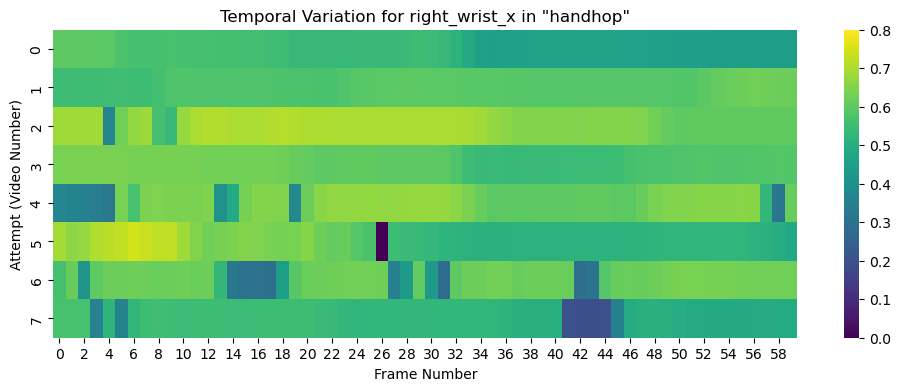

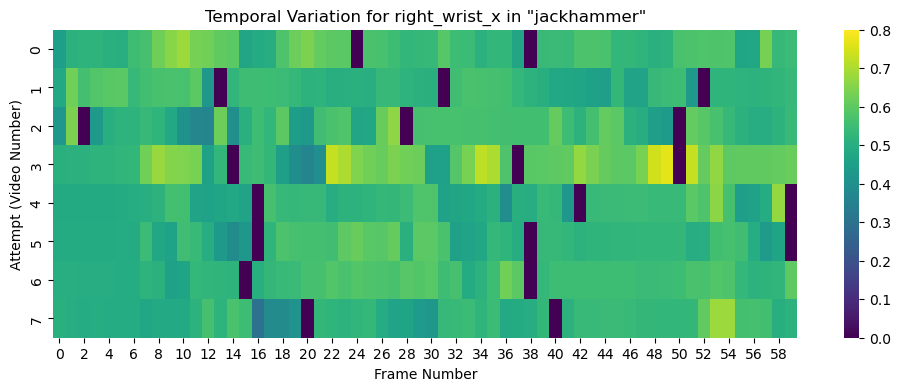

In [36]:
# right_wrist_x
plot_temporal_variation(landmark_df, 'cc', 'right_wrist_x', vmin=0.2, vmax=0.9)
plot_temporal_variation(landmark_df, 'handhop', 'right_wrist_x', vmin=0.0, vmax=0.8)
plot_temporal_variation(landmark_df, 'jackhammer', 'right_wrist_x', vmin=0.0, vmax=0.8)

### Temporal Variation of right_wrist_y

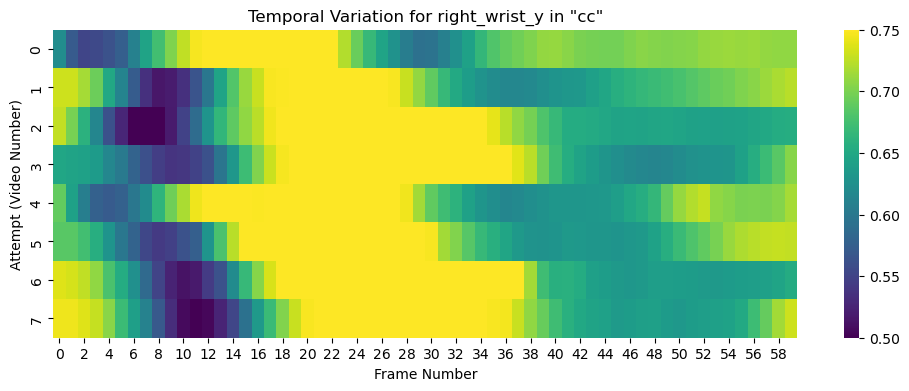

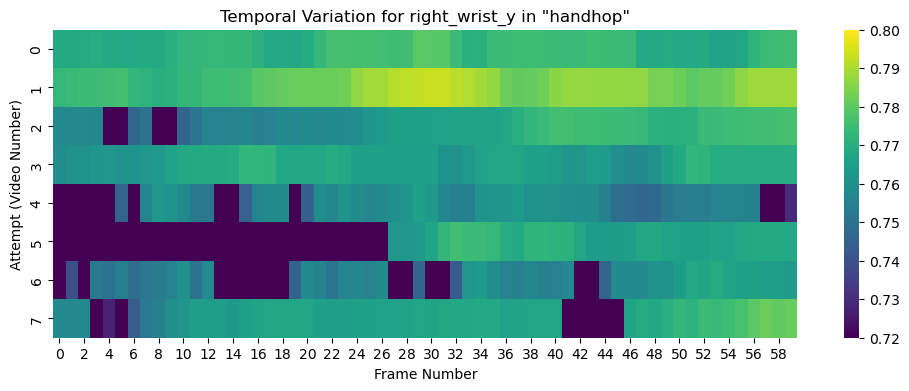

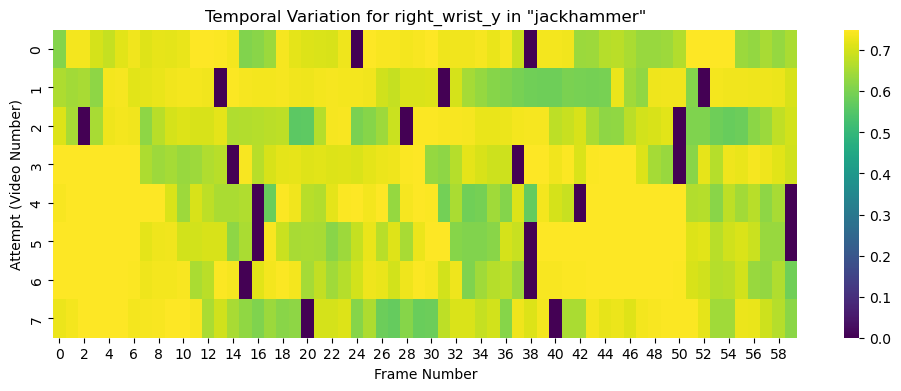

In [37]:
# right_wrist_y
plot_temporal_variation(landmark_df, 'cc', 'right_wrist_y', vmin=0.5, vmax=0.75)
plot_temporal_variation(landmark_df, 'handhop', 'right_wrist_y', vmin=0.72, vmax=0.8)
plot_temporal_variation(landmark_df, 'jackhammer', 'right_wrist_y', vmin=0.0, vmax=0.75)

### Temporal Variation of right_wrist_z

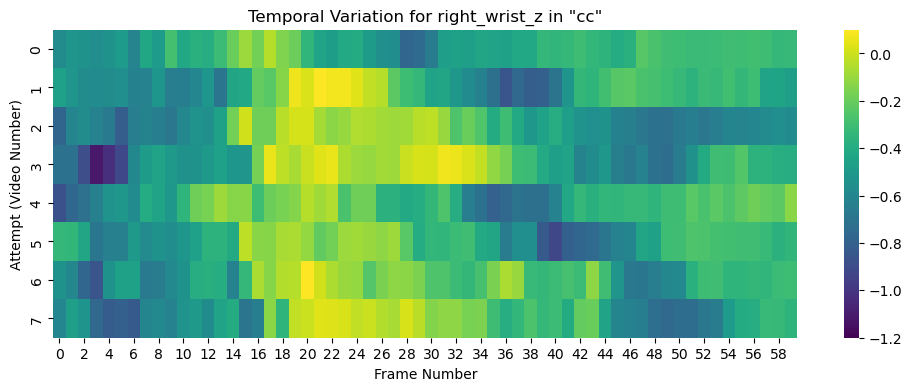

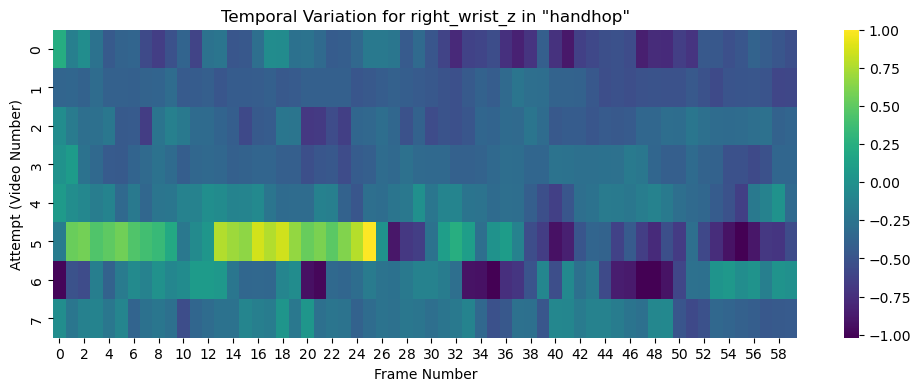

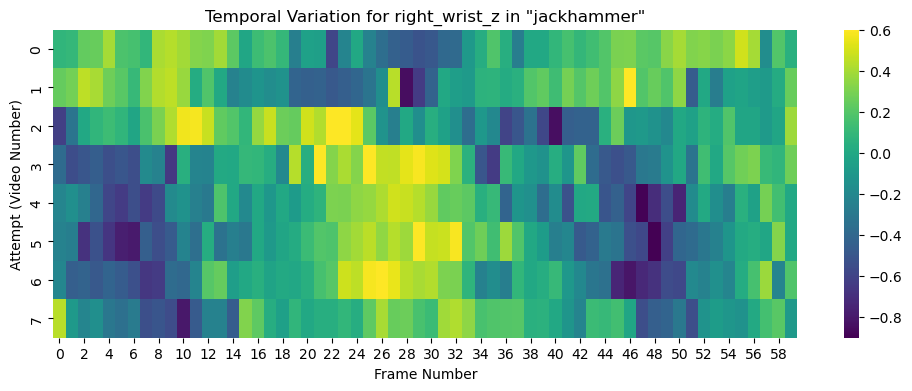

In [38]:
# right_wrist_z
plot_temporal_variation(landmark_df, 'cc', 'right_wrist_z', vmin=-1.2, vmax=0.1)
plot_temporal_variation(landmark_df, 'handhop', 'right_wrist_z', vmin=-1.02, vmax=1.0)
plot_temporal_variation(landmark_df, 'jackhammer', 'right_wrist_z', vmin=-0.9, vmax=0.6)

**Observations and insights for right_wrist_x, right_wrist_y and right_wrist_z**

**CC:**

There are variation seen starting from the first 20 frames in all the attempts which indicates the swinging movement of the right upper limb to the back. The pattern seems to be consistent for all the attempts.

**Handhop:**

It is observed that the high variation across the frames is seen in the 6th attempt as the value is increasing which indicates that the dancer is travelling as he executes the move.

**Jackhammer:**

The variation across the frames for each attempt is not as gradual as the one we see in "cc". It is probably due to the rapid movement and the travelling caused by the hoppings.

**Insights**

The unique temporal fluctuations of right_wrist_x, right_wrist_y and right_wrist_z in the 3 moves may improve models that identify sequential patterns.

### Temporal Variation of right_ankle_z

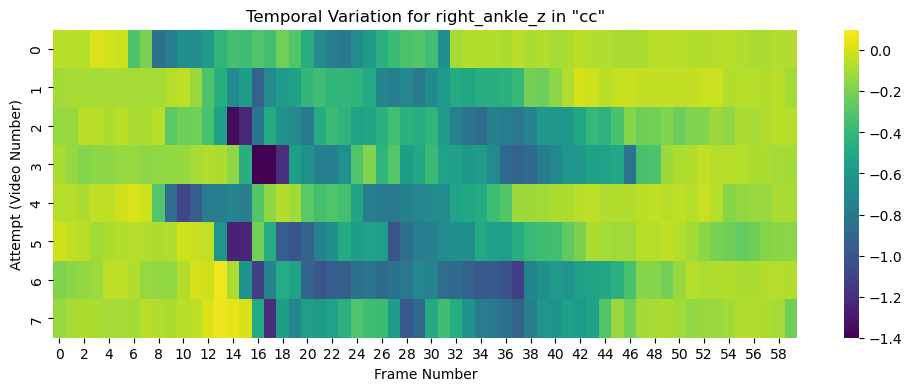

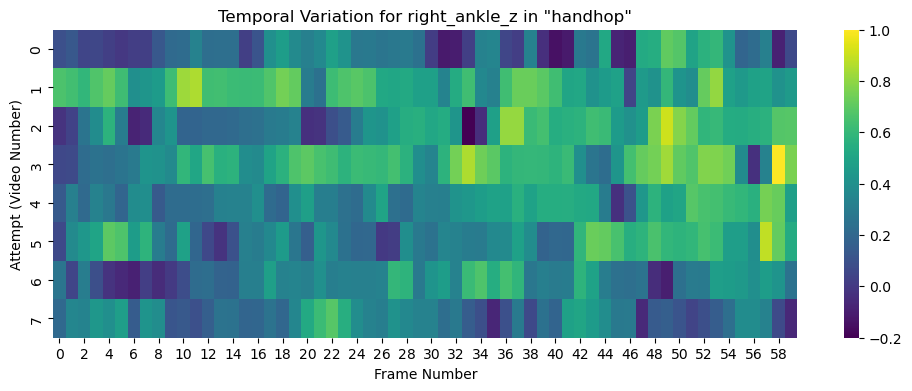

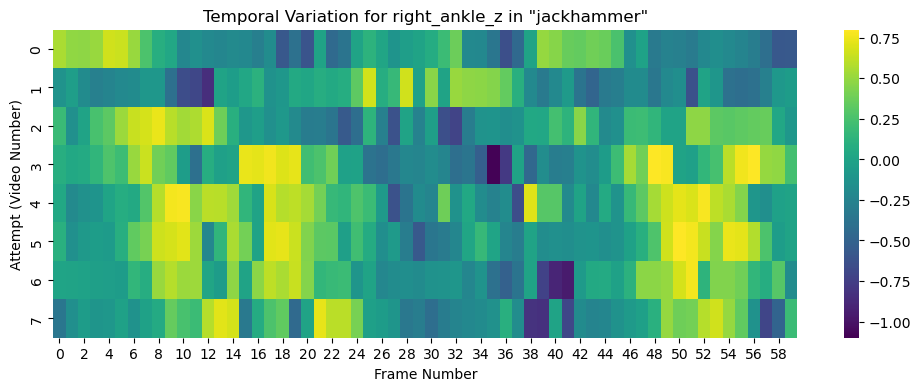

In [39]:
# right_ankle_z
plot_temporal_variation(landmark_df, 'cc', 'right_ankle_z', vmin=-1.4, vmax=0.1)
plot_temporal_variation(landmark_df, 'handhop', 'right_ankle_z', vmin=-0.2, vmax=1)
plot_temporal_variation(landmark_df, 'jackhammer', 'right_ankle_z', vmin=-1.1, vmax=0.8)

### Temporal Variation of left_ankle_z

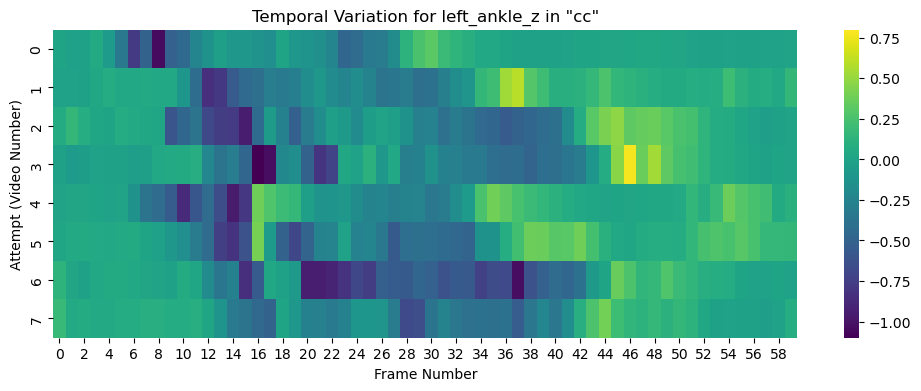

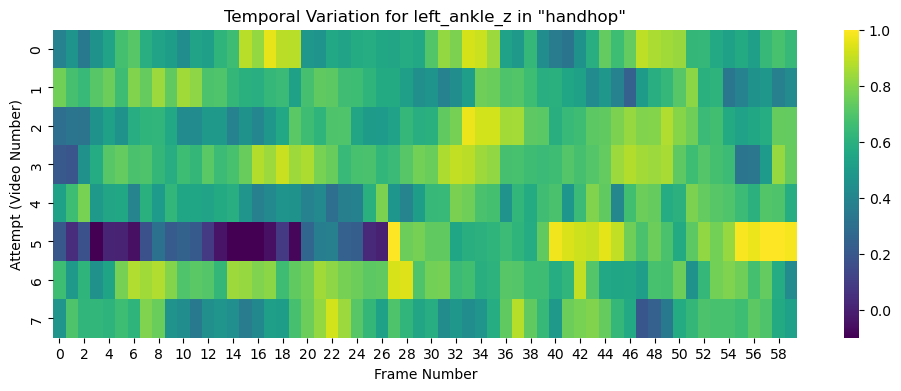

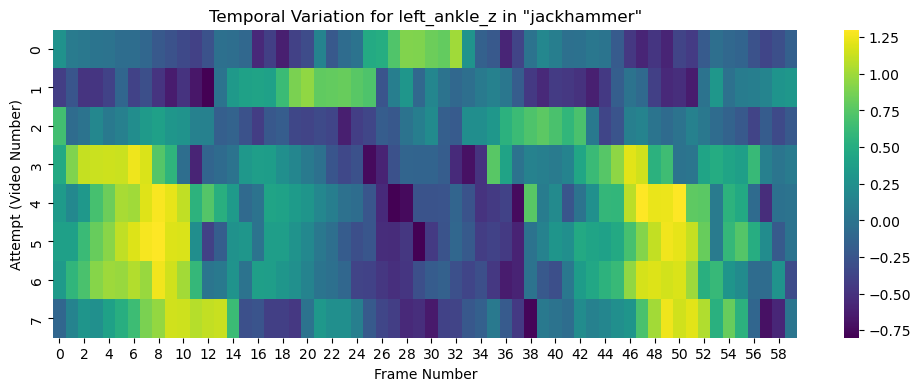

In [40]:
# left_ankle_z
plot_temporal_variation(landmark_df, 'cc', 'left_ankle_z', vmin=-1.1, vmax=0.8)
plot_temporal_variation(landmark_df, 'handhop', 'left_ankle_z', vmin=-0.1, vmax=1)
plot_temporal_variation(landmark_df, 'jackhammer', 'left_ankle_z', vmin=-0.8, vmax=1.3)

**Observations and insights for right_ankle_z and left_ankle_z**

**CC:**

There are variations seen starting from the first 20 frames in all the attempts which indicates the swinging movement of the right upper limb to the back. The pattern seems to be consistent for all the attempts.

**Handhop:**

There are variations seen as across all the frames that indicates how each hop will influence the subsequent ones.

**Jackhammer:**

The variation across the frames for each attempt is not as gradual as the one we see in "cc". It is probably due to the rapid movement and the travelling caused by the hoppings.

**Insights**

The unique temporal fluctuations of right_ankle_z and left_ankle_z in the three dances may improve models that identify sequential patterns.

The unique temporal patterns among the different landmarks and moves can be used as an advantage for models that can utilize these patterns to differentiate between dance moves. 

This is because they are considering the full context of the movement, not just isolated positions.

### Bar Plot for  'right_wrist_x', 'right_wrist_y', 'right_wrist_z', 'right_ankle_z', 'left_ankle_z'


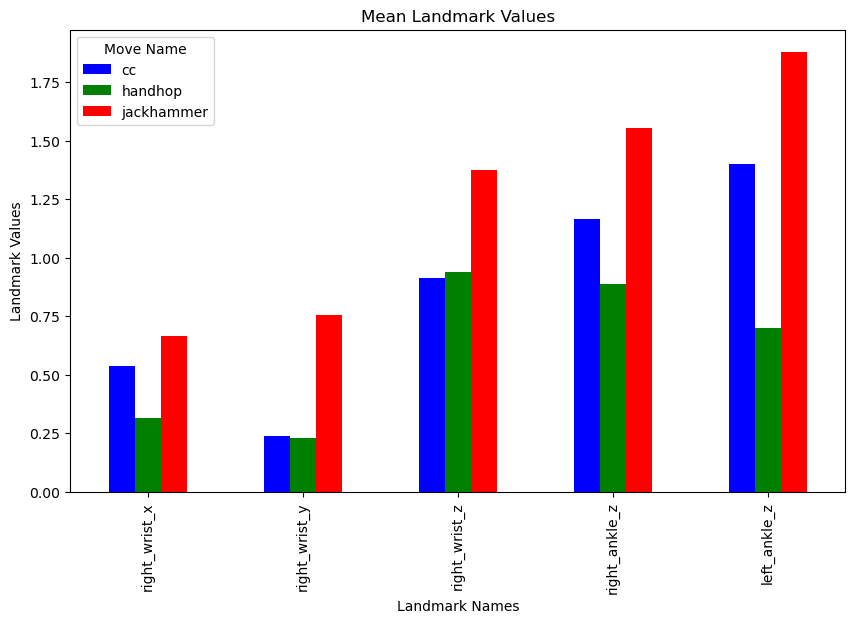

In [41]:
#selected landmarks

range_motion_gb = range_motion_df.groupby('move_name').mean()
range_motion_gb = range_motion_gb.drop(columns=['video_num'])

data = range_motion_gb[['right_wrist_x', 'right_wrist_y', 'right_wrist_z', 'right_ankle_z', 'left_ankle_z']]

# Transpose the data for easier plotting
data = data.transpose()

# Define colors for each move_name
colors = {'cc': 'blue', 'handhop': 'green', 'jackhammer': 'red'}

# Plot the data
data.plot(kind='bar', color=[colors.get(move, 'gray') for move in data.columns], figsize=(10, 6))
plt.title('Mean Landmark Values')
plt.xlabel('Landmark Names')
plt.ylabel('Landmark Values')
plt.legend(title='Move Name', loc='upper left')

# Show the plot
plt.show()

**Insights:**

* Jackhammer has the highest landmark mean values, indicating more extensive movement.
* Handhop has the lowest mean values for right_wrist_x, left_ankle_z and right_ankle_z, possibly reflecting smaller movements in these areas.
* The left_ankle_z shows the most significant difference between moves, with "jackhammer" having the highest mean value, indicating this landmark's movement is crucial for distinguishing this move.

### KDE (Kernel Density Estimation) Plot

### Create User Defined Function: plot_kde
---
* Visualizes the distribution of a landmark across different moves



**plot_kde**

Parameters:

* data
* column_name

Function:

1. Converts the Dataframe to long format.
3. Display Kernel Density Estimate (KDE) plot. 

In [42]:
def plot_kde(data, column_name):
    # Melt the DataFrame to long format
    data_melted = pd.melt(data, id_vars=['move_name'], value_vars=[column_name], var_name='landmark', value_name='coordinate')
    
    # Increase the size of the plot by adjusting the height and aspect ratio if needed
    plt.figure(figsize=(10, 6))  # You can adjust the figure size as needed
    sns.kdeplot(data=data_melted, x='coordinate', hue='move_name', fill=True)
    
    # Set the title and labels
    plt.title(f'Distribution for "{column_name}" Range of Motion', size=16)
    plt.xlabel(f'"{column_name}" Range of Motion Value')
    plt.ylabel('Density')
    
    # Show the plot
    plt.show()


### KDE Plot 'right_wrist_x', 'right_wrist_y', 'right_wrist_z', 'right_ankle_z', 'left_ankle_z'

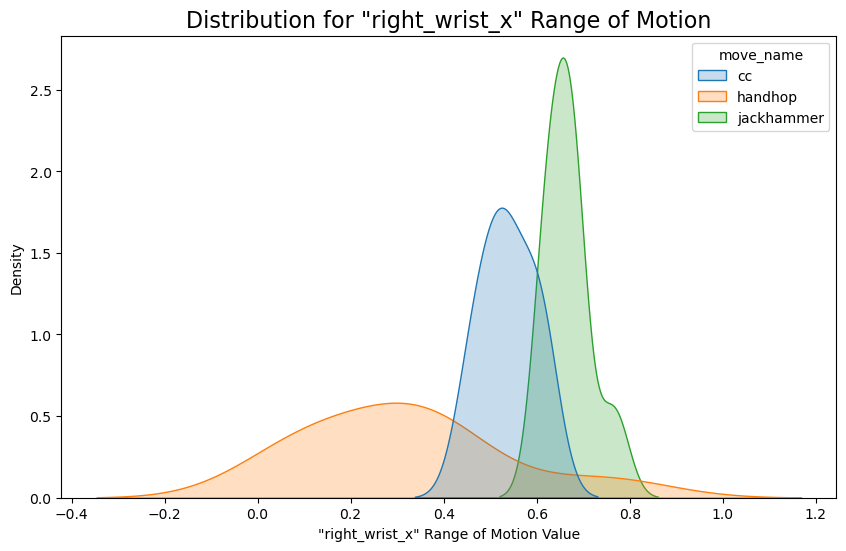

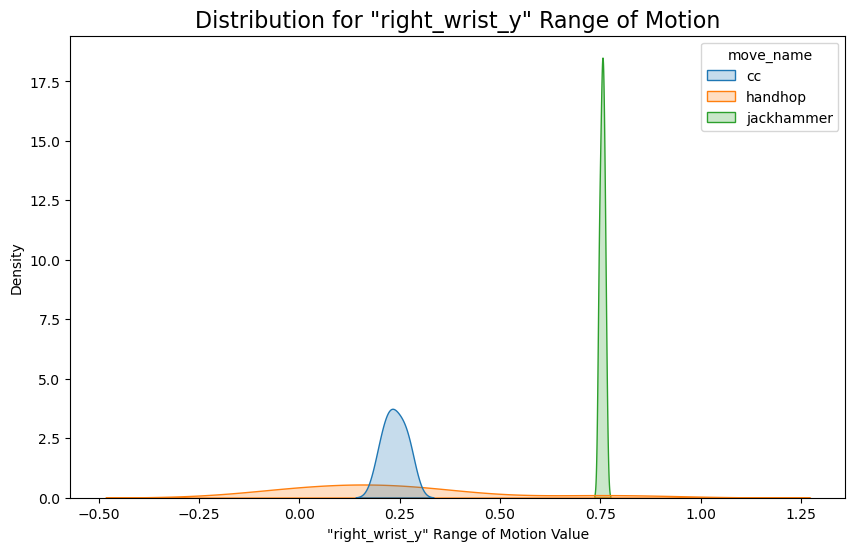

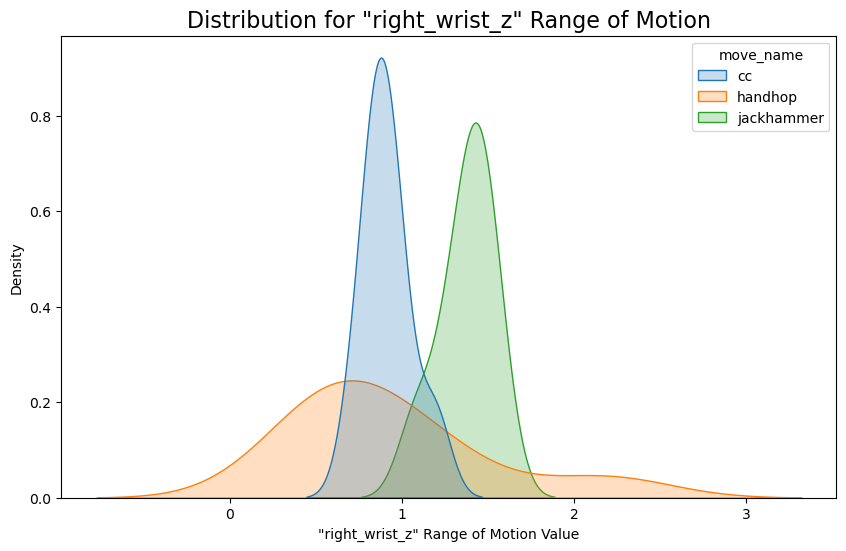

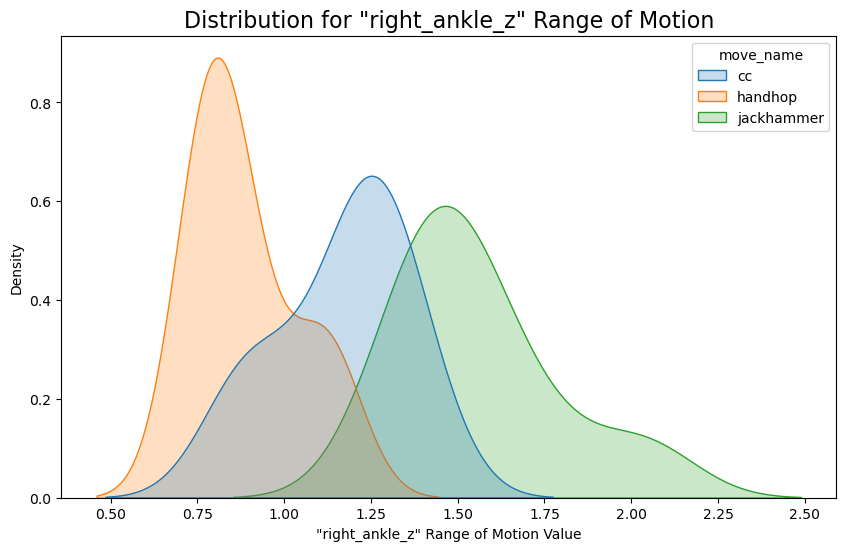

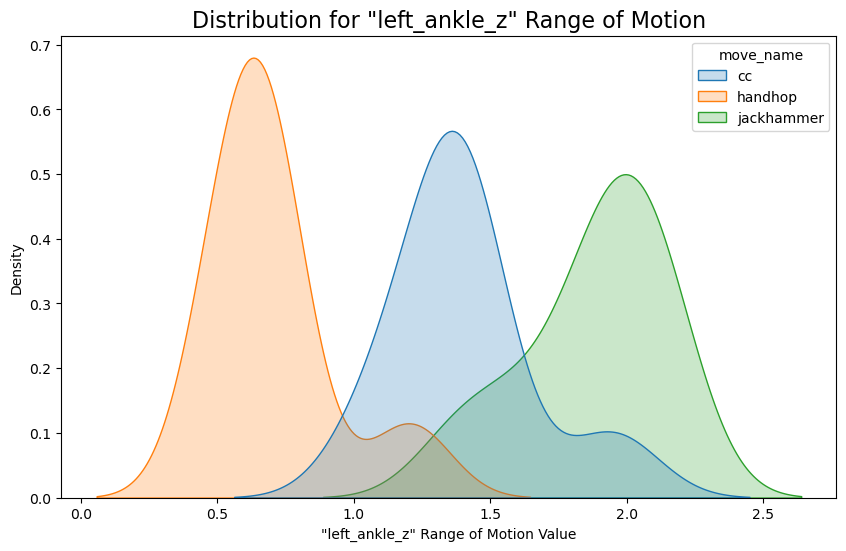

In [43]:
plot_kde(range_motion_df, 'right_wrist_x')
plot_kde(range_motion_df, 'right_wrist_y')
plot_kde(range_motion_df, 'right_wrist_z')
plot_kde(range_motion_df, 'right_ankle_z')
plot_kde(range_motion_df, 'left_ankle_z')

**right_wrist_x:**

* The distribution for handhop is more spread out, suggesting a wider range of movement in the x direction.
* Jackhammer shows a narrower peak, indicating more consistent positioning.
* CC has a distribution that is somewhat in between the two, suggesting moderate variability.


**right_wrist_y:**

* The CC move shows a peak around the middle value, suggesting some consistent movements in the y direction.
* Jackhammer has a spike, potentially indicating a specific, repeated movement.
* Handhop is quite dispersed, showing a lot of variation in the y coordinate.


**right_wrist_z:**

* CC has a peak indicating a range of movement that is most common.
* Handhop and Jackhammer have broader distributions, implying a variety of movements in the z direction.


**right_ankle_z:**

* CC and Jackhammer have broader, flatter curves, indicating variability in the right ankle's z movement.
* Handhop has a narrower distribution, suggesting a more consistent ankle height.


**left_ankle_z:**

* Each move has a distinct peak, indicating different typical ankle heights for these moves.


**Insights**

* The distributions suggest that some moves have specific, characteristic movements that could be key in identifying them.

* The overlap in distributions for some moves means that a single coordinate's movement might not be sufficient for classification, and combining multiple coordinates or landmarks might be necessary.

### Line Plot
---

Visualizes the variation over time of a specific landmark and video attempt among the different moves with line plot

### Create User Defined Function: plot_line_compare
---

* Visualizes the variation over time of a specific landmark and video attempt among the different moves with line plot



**plot_line_compare**

Parameters:

* landmark_df
* video_name1
* video_name2
* video_name3
* selected_column

Function:

1. Filters the input DataFrame (landmark_df) to obtain data for three specific videos, identified by video_name1, video_name2, and video_name3. It extracts data corresponding to each video, focusing on a specified column (selected_column), which represents a particular variable of interest (like a coordinate or a landmark).
3. Display line plot.

In [44]:
def plot_line_compare(landmark_df, video_name1, video_name2, video_name3, selected_column):
    # Filter the DataFrame for the specified video names
    data1 = landmark_df[landmark_df["video_name"] == video_name1]
    data2 = landmark_df[landmark_df["video_name"] == video_name2]
    data3 = landmark_df[landmark_df["video_name"] == video_name3]

    # Create a figure and axis with a larger width
    fig, ax = plt.subplots(figsize=(12, 6))

    # Set the style to seaborn
    sns.set(style="darkgrid")

    # Plot data for video_name1 using Seaborn lineplot
    sns.lineplot(data=data1, x="frame", y=selected_column, label=f"{video_name1} - {data1['move_name'].iloc[0]}", ax=ax)

    # Plot data for video_name2 using Seaborn lineplot
    sns.lineplot(data=data2, x="frame", y=selected_column, label=f"{video_name2} - {data2['move_name'].iloc[0]}", ax=ax)

    # Plot data for video_name3 using Seaborn lineplot
    sns.lineplot(data=data3, x="frame", y=selected_column, label=f"{video_name3} - {data3['move_name'].iloc[0]}", ax=ax)

    # Set axis labels and title
    ax.set_xlabel("Frame")
    ax.set_ylabel(selected_column)
    ax.set_title(f"{selected_column} Comparison")

    # Move the legend outside the plot to the right
    ax.legend(loc="upper left", bbox_to_anchor=(1, 1))

    # Display the plot
    plt.show()

### Line Plot 'right_wrist_x', 'right_wrist_y', 'right_wrist_z', 'right_ankle_z', 'left_ankle_z'

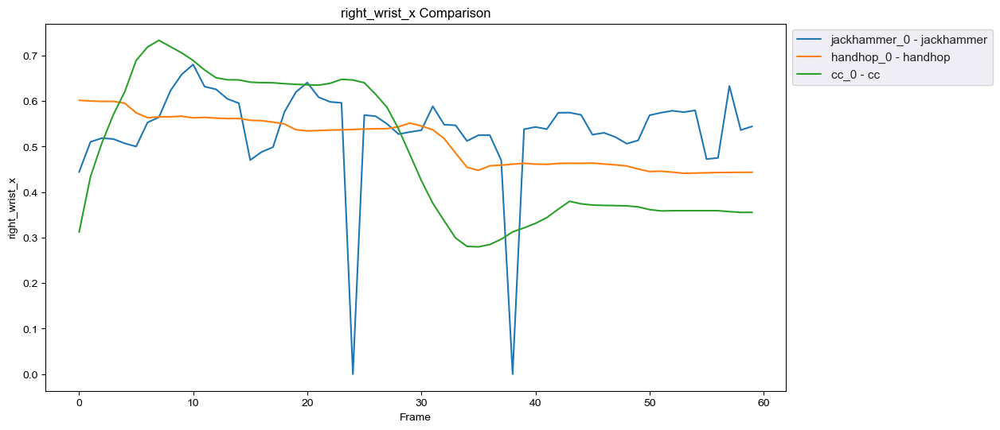

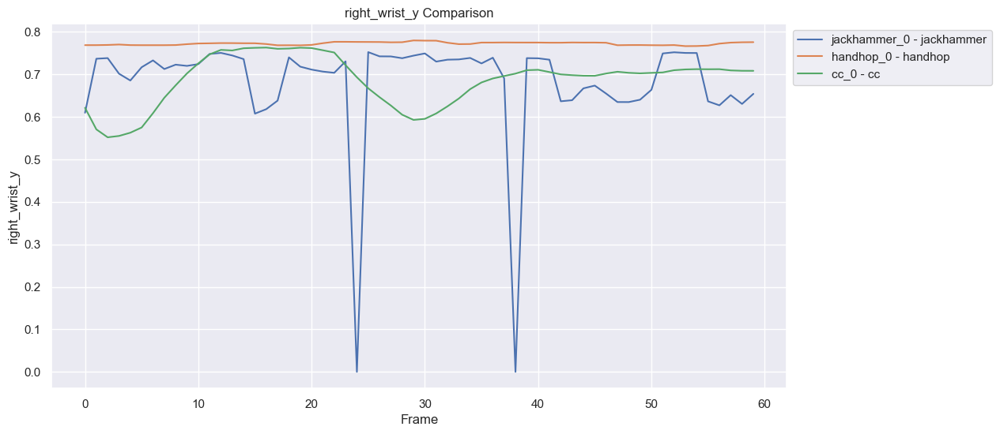

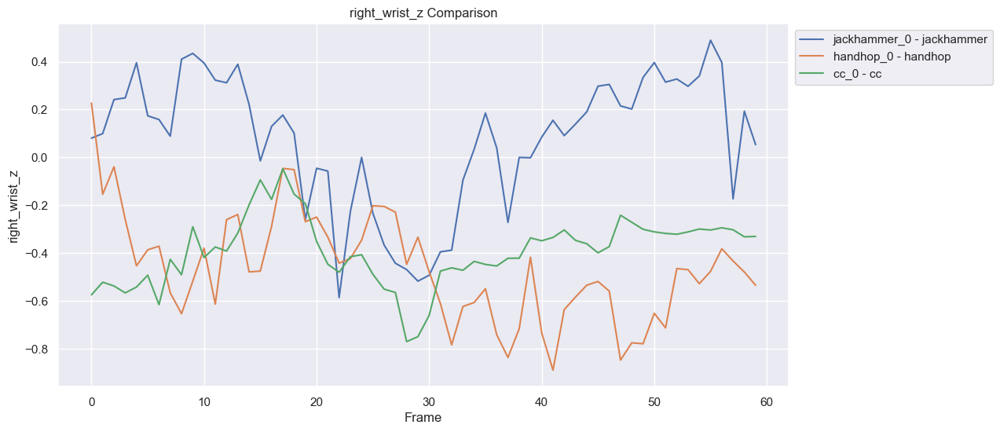

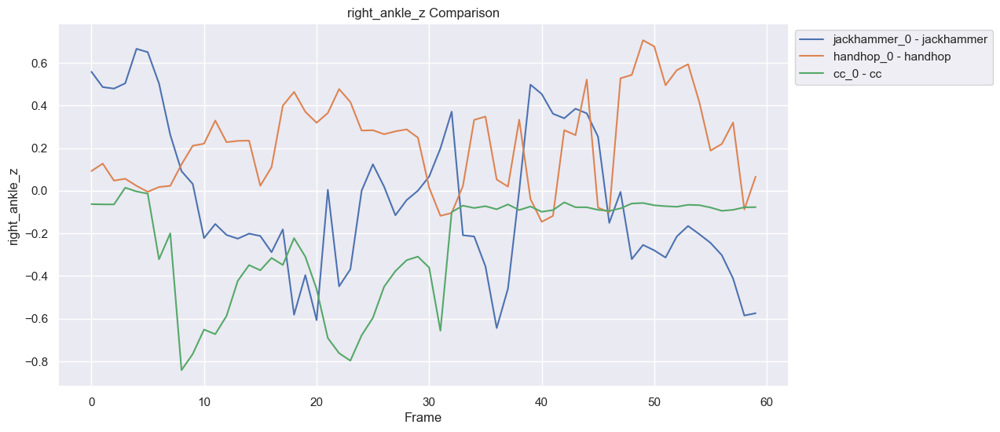

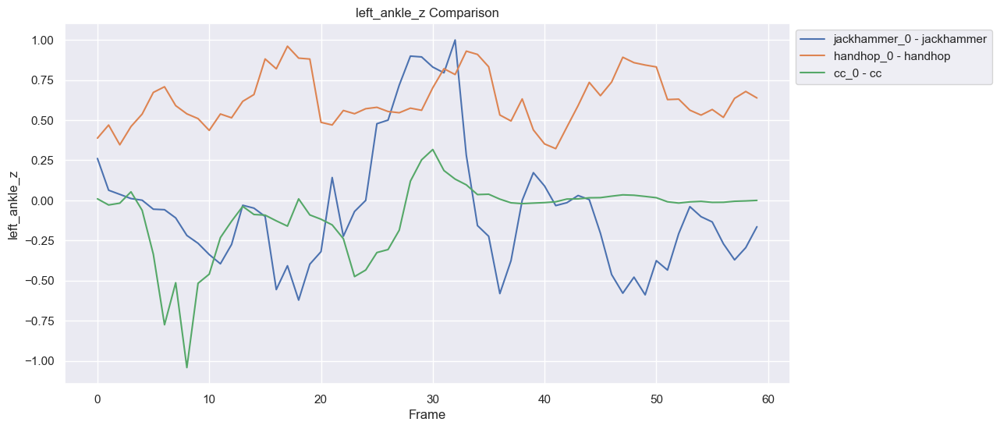

In [45]:
plot_line_compare(landmark_df, "jackhammer_0", "handhop_0", "cc_0", "right_wrist_x")
plot_line_compare(landmark_df, "jackhammer_0", "handhop_0", "cc_0", "right_wrist_y")
plot_line_compare(landmark_df, "jackhammer_0", "handhop_0", "cc_0", "right_wrist_z")
plot_line_compare(landmark_df, "jackhammer_0", "handhop_0", "cc_0", "right_ankle_z")
plot_line_compare(landmark_df, "jackhammer_0", "handhop_0", "cc_0", "left_ankle_z")

**right_wrist_x:**

Jackhammer shows high variability with significant fluctuations across frames.
Handhop displays moderate consistency with some fluctuations.
CC move is relatively stable, indicating limited movement in the right wrist's x-coordinate. The dip at frame 30 onwards indicates that the right upper limb is swinging to the left and stablizes after hitting the pose.




**right_wrist_y:**

Jackhammer shows high variability with significant fluctuations across frames.
Handhop has minimal variation, suggesting consistent y-coordinate positioning.
CC move is relatively stable, indicating limited movement in the right wrist's y coordinate. The dip at frame 30 onwards indicates that the right upper limb is swinging to the left and stablizes after hitting the pose.





**right_wrist_z:**

Jackhammer a dip around frame 30, indicating that the body is spinning.
Handhop and CC have shown variability as well.



**right_ankle_z and left_ankle_z:**

Jackhammer demonstrates the greatest variation, indicative of active and varied ankle movements.
Handhop shows less fluctuation than Jackhammer but is more varied than CC.
CC is relatively stable, suggesting less movement of the right ankle in the vertical plane. The increased in the value at frame 30 onwards indicates that the right lower limb that kicked towards the camera stablizes after hitting the pose.






**Insights:**

* The jackhammer is characterized by the most significant movement across all coordinates, which may require a data model that can handle high variance and rapid changes.


* The handhop move, while less variable than jackhammer, still shows some movement.


* The CC move is the most stable, suggesting that a less complex model might suffice to capture its more consistent and controlled movements.


* These differences in movement dynamics across the moves could be leveraged to distinguish between them in a machine learning model, utilizing the variability and consistency patterns as key features.

### Heatmap to Detect Multicollinearity


In [46]:
landmark_df_heatmap = landmark_df.drop(['videolandmarks_path',
                                'videolandmarks_name',
                                'video_name',
                                'bboy_name',
                                'move_name',
                                'frame',
                                'video_num'
                               ], axis=1)

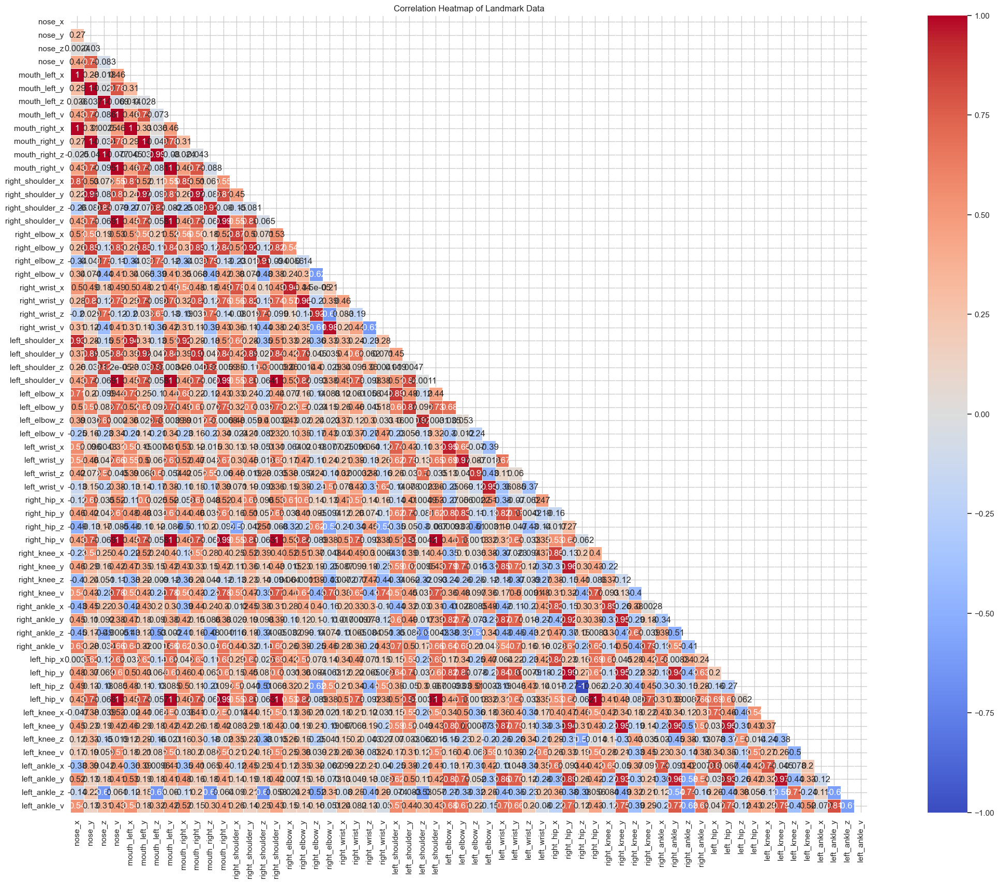

In [47]:
# Set up the figure size for the heatmap
plt.figure(figsize=(30, 20))

# Calculating the correlation matrix for the numeric columns
corr = landmark_df_heatmap.corr()

# Creating a mask for the upper triangle
mask = np.zeros_like(corr, dtype=bool)
mask[np.triu_indices_from(mask)] = True

# Drawing the heatmap with the mask and correct aspect ratio
with sns.axes_style('whitegrid'):
    sns.heatmap(corr, mask=mask, square=True, annot=True, cmap='coolwarm', 
                vmin=-1, vmax=1, linewidths=.5)

# Adding a title to the heatmap
plt.title('Correlation Heatmap of Landmark Data');

# Show the heatmap
plt.show()

**Remarks:**

* It is very difficult to make interpretion as there are too many pairs of features.
* A dataframe will be create to include features that has absolute correlation value of 0.8 and above.

In [48]:
# Calculating the correlation matrix numeric data only
corr_matrix = landmark_df.corr(numeric_only=True)

# Pairs of features with high absolute correlation
high_corr = (corr_matrix.abs() >= 0.8) & (corr_matrix != 1)

# landmark_df_corr to store highly correlated features
landmark_df_corr = pd.DataFrame(columns=['Feature1', 'Feature2', 'Correlation'])

# Looping through the correlation matrix to find and add high correlations
rows = []
for i in range(len(high_corr.columns)):
    for j in range(i):
        if high_corr.iloc[i, j]:
            row = {
                'Feature1': corr_matrix.columns[i],
                'Feature2': corr_matrix.columns[j],
                'Correlation': corr_matrix.iloc[i, j]
            }
            rows.append(row)

# Concatenating rows to landmark_df_corr
landmark_df_corr = pd.concat([landmark_df_corr, pd.DataFrame(rows)], ignore_index=True)

# Sorting landmark_df_corr by absolute value of correlation for better readability
landmark_df_corr['Abs_Correlation'] = landmark_df_corr['Correlation'].abs()
landmark_df_corr = landmark_df_corr.sort_values(by='Abs_Correlation', ascending=False).drop('Abs_Correlation', axis=1)

In [49]:
landmark_df_corr.shape

(122, 3)

In [50]:
landmark_df_corr

,Feature1,Feature2,Correlation
108,left_hip_v,right_hip_v,0.999999
99,left_hip_z,right_hip_z,-0.999993
61,left_shoulder_v,right_shoulder_v,0.999926
107,left_hip_v,left_shoulder_v,0.999726
81,right_hip_v,left_shoulder_v,0.999725
11,mouth_right_v,mouth_left_v,0.999629
78,right_hip_v,right_shoulder_v,0.999572
104,left_hip_v,right_shoulder_v,0.999569
3,mouth_left_v,nose_v,0.999295
7,mouth_right_y,mouth_left_y,0.998878


**Insight and Comments:**

There are 122 pairs of features with high correlation value. However, no feature will be dropped.

**Reasons:**


* **Complex Movements:** 

Bboying involves complex, full-body movements where multiple body parts often move in coordination. Each landmark captures a crucial aspect of the movement, and removing any could omit important information necessary for accurate classification.


* **Unique Information:** 

Even if some landmarks are highly correlated, they may still provide unique information about different aspects of the dance moves. For example, while the right and left wrists may move together, they might have different roles in different moves that are important to capture.


* **Temporal Dynamics:** 

The correlation between landmarks might change over time as the dancer moves. Keeping all landmarks allows the model to capture these temporal dynamics, which are essential for recognizing the sequences of movements in bboying.


* **Model Robustness:** 

Advanced machine learning models, especially neural networks, can handle high dimensionality and multicollinearity. These models can learn the underlying patterns in the data even when features are correlated.